In [1]:
import datetime
import calendar
import collections
from operator import itemgetter

import numpy as np
import pandas as pd

# Networks 
import networkx as nx
# Community Detection
import community as community_louvain 
# import pycombo 

# Visualization
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns

# Interactive Maps/Visaualization
import folium
from folium import plugins
import plotly.graph_objects as go

# Custom Colors
MAGENTA = "#6C3483"
GREEN = "#239B56"
BLUE = "#5DADE2"

In [ ]:
dataframe = pd.read_csv("database.csv", low_memory=False)
dataframe.head()

In [ ]:
dataframe[['departure','return']] =  dataframe[['departure','return']].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S.%f')

dataframe = dataframe.rename(columns={'distance (m)': 'distance',
                                     'duration (sec.)': 'duration',
                                     'avg_speed (km/h)':'speed',
                                      'Air temperature (degC)':'temperature',
                                     })
dataframe = dataframe[ 
                    (50 < dataframe['distance']) & (dataframe['distance'] < 10000) &
                    (120 < dataframe['duration']) & (dataframe['duration'] <  18000) &
                    (-20 < dataframe['temperature']) & (dataframe['temperature'] < 50)        
                    ]    
    

## Exploratory Data Analysis

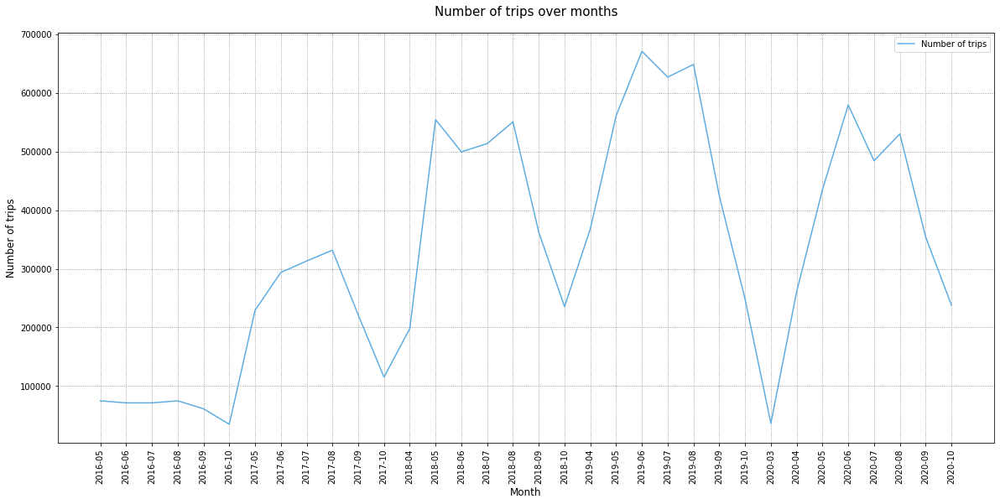

In [167]:
"""Add a trend line to the chart"""
df = dataframe.copy()
# df_by_year = df.groupby([(df['departure'].dt.year),(df['departure'].dt.month)]).count()

# df['year'] = df['departure'].dt.year
# df['month'] = df['departure'].dt.month
df['Month'] = pd.to_datetime(df['departure']).dt.strftime('%Y-%m')
# df_by_year = df.groupby([df['year'],df['month']]).size().reset_index(name='number of trips')
df_by_year = df.groupby(df['Month']).size().reset_index(name='number of trips')
# df_by_year
fig, ax = plt.subplots(figsize=(20,9))
plt.plot(df_by_year["Month"], df_by_year["number of trips"], color= BLUE)

ax.set_title("Number of trips over months", fontsize= 15, pad= 20)
ax.set_ylabel("Number of trips", fontsize=12)
ax.set_xlabel("Month", fontsize=12)
plt.xticks(rotation=90)

plt.grid(linestyle=":", color='grey')
plt.legend(["Number of trips"])

In [ ]:
year_2016 = dataframe[(dataframe['departure'] >= '2016-01-01') & (dataframe['departure'] <= '2016-12-31')]
year_2017 = dataframe[(dataframe['departure'] >= '2017-01-01') & (dataframe['departure'] <= '2017-12-31')]
year_2018 = dataframe[(dataframe['departure'] >= '2018-01-01') & (dataframe['departure'] <= '2018-12-31')]
year_2019 = dataframe[(dataframe['departure'] >= '2019-01-01') & (dataframe['departure'] <= '2019-12-31')]
year_2020 = dataframe[(dataframe['departure'] >= '2020-01-01') & (dataframe['departure'] <= '2020-12-31')]

In [ ]:
year_list = [year_2016,year_2017,year_2018,year_2019,year_2020]
y = [2016,2017,2018,2019,2020]

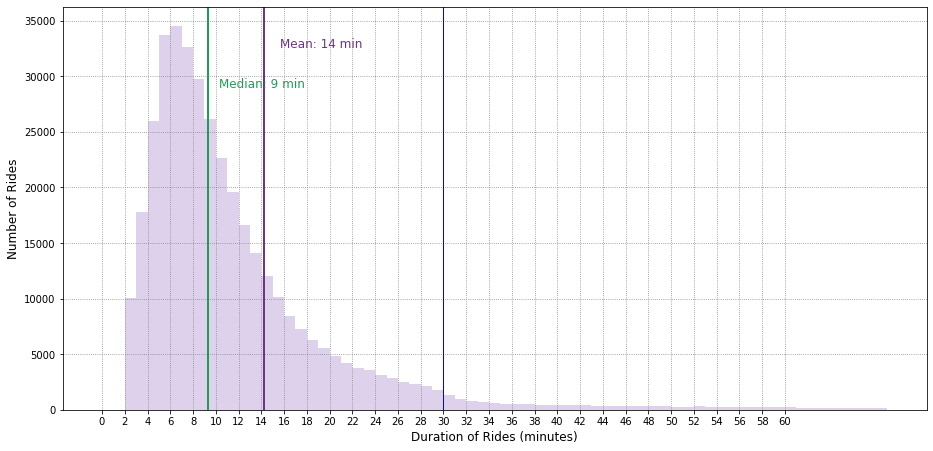

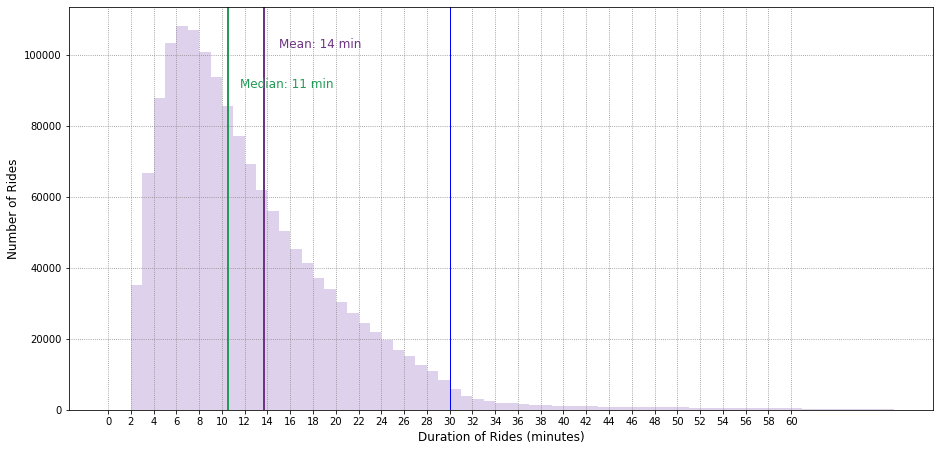

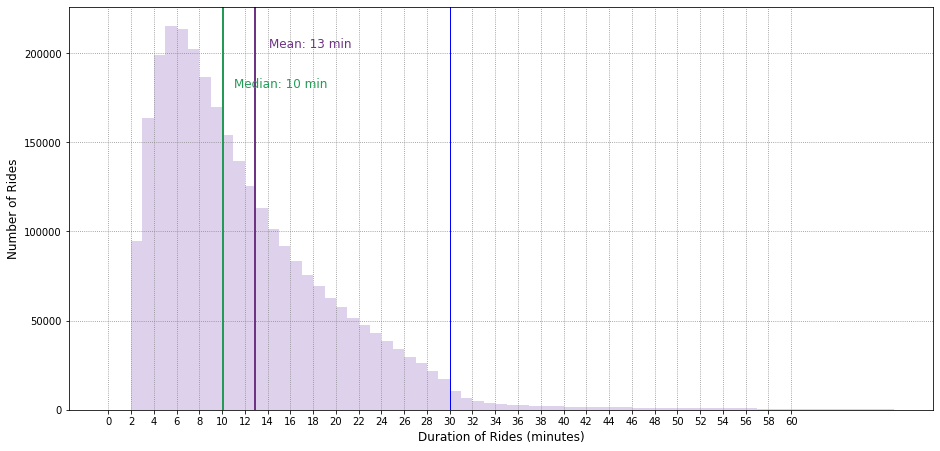

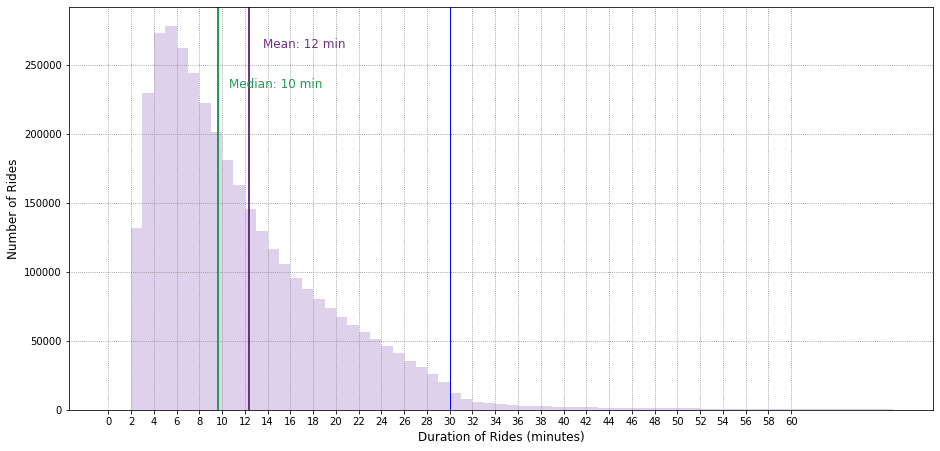

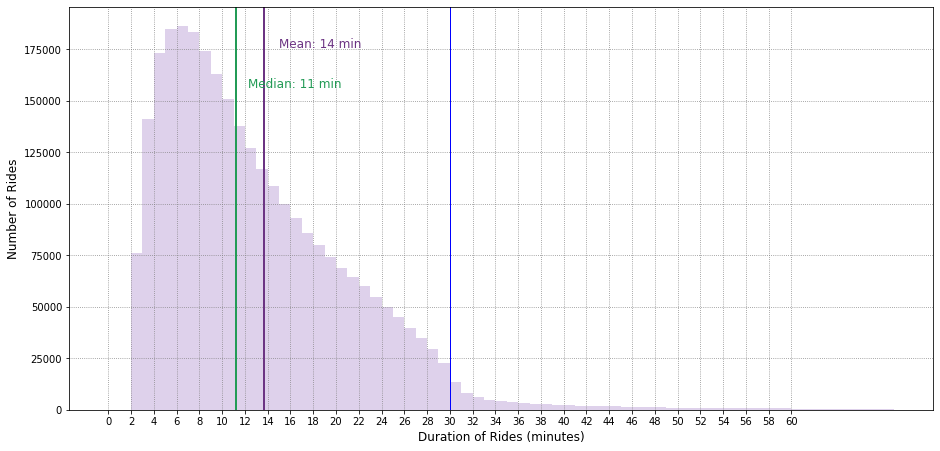

In [181]:
def duration(dataframe):
    """
    """
    df = dataframe.copy()
    
    # Converting seconds to minutes
    df["duration"] = df["duration"]/60
    
    # Filtering relevant data
    duration_data = df["duration"]
    fig = plt.figure(figsize=(15,7))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

    # Ploting the histogram
    #plt.subplot(2, 3, i)
    plt.hist(duration_data, bins = range(70), color = 'tab:purple', alpha=0.3, histtype ="bar")

    # Adding median and mean lines
    plt.axvline(df["duration"].mean(), color=MAGENTA, linestyle='-', linewidth=2 )
    plt.axvline(df["duration"].median(), color=GREEN, linestyle='-', linewidth=2 )
    plt.axvline(x = 30, color="blue", linestyle='-', linewidth=1 )

    # Adding median and mean texts
    min_ylim, max_ylim = plt.ylim()
    plt.text(df["duration"].mean()*1.1, max_ylim*0.9, 'Mean: {:.0f} min'.format(df["duration"].mean()), color = MAGENTA,  fontsize= 12)
    plt.text(df["duration"].median()*1.1, max_ylim*0.8, 'Median: {:.0f} min'.format(df["duration"].median()), color = GREEN, fontsize= 12)
    # plt.text(x= 28,y=200000, s="Free", color = GREEN, fontsize= 12)
    # plt.text(x= 30.5,y=200000, s="Extra Charge", color = "grey", fontsize= 12)

    # Seting ticks on x axis
    ticks =range(0, 62, 2)
    plt.xticks(ticks)
    # Seting ticks on y axis
    ticks =range(0, 3600, 2000)

    # Labeling Axes
    plt.xlabel("Duration of Rides (minutes)", fontsize= 12, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)

    # Adding Grid
    plt.grid(linestyle=":", color='grey')

    plt.show()

for i in range(5):
    duration(data_list[i])

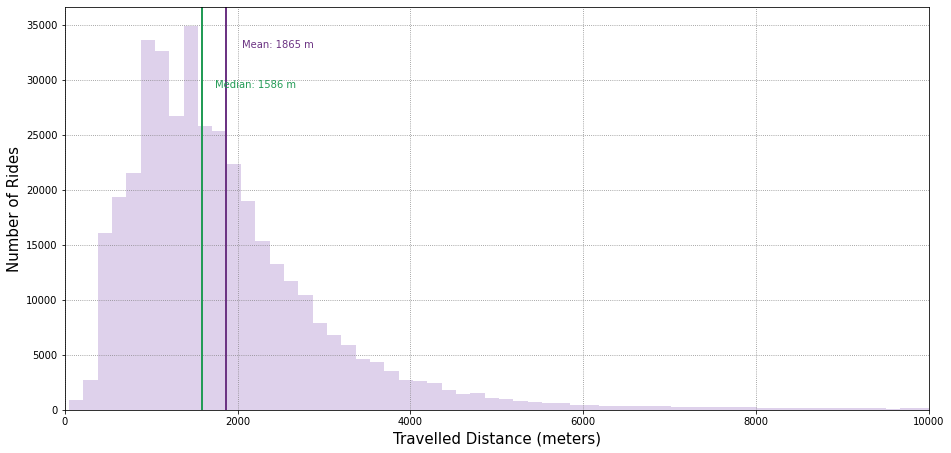

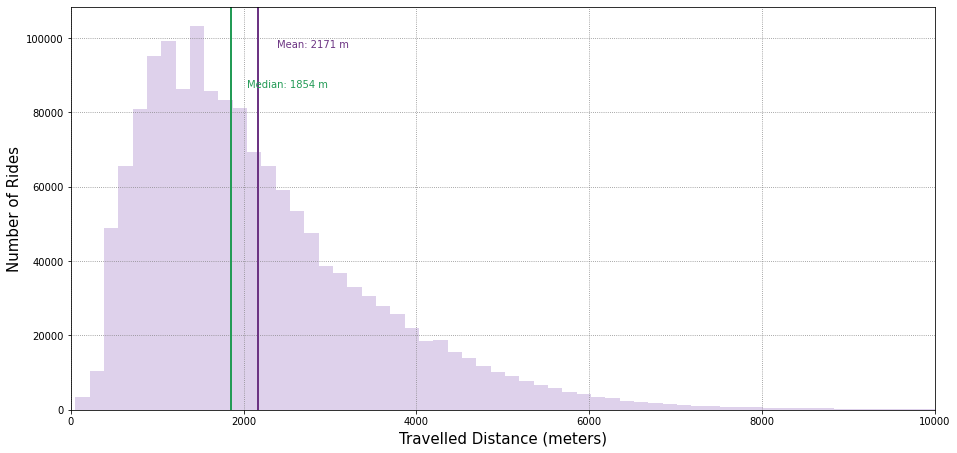

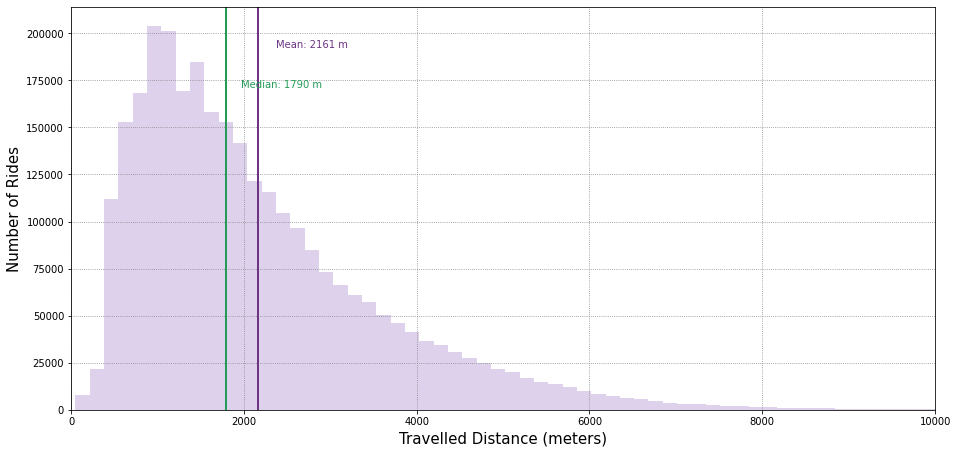

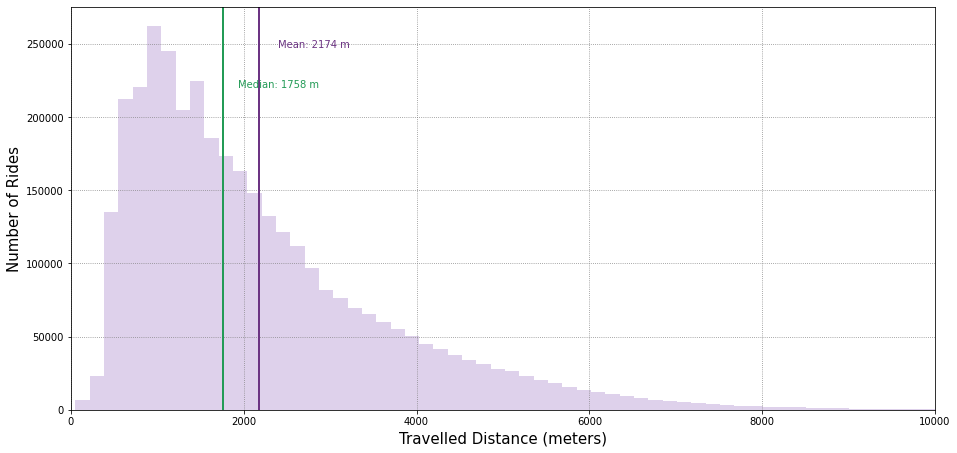

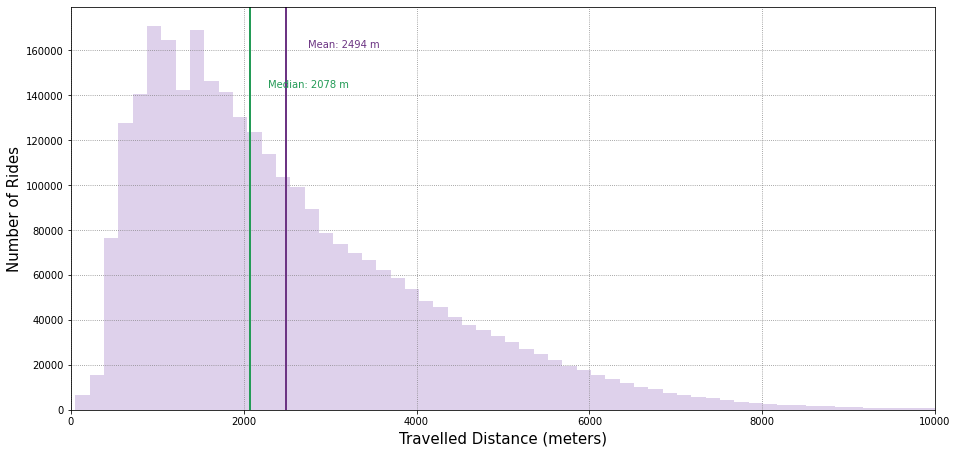

In [180]:
def distance(dataframe):
    """
    
    """
    df = dataframe.copy()
    
    fig = plt.figure(figsize=(15,7))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

    data = df["distance"]
    plt.hist(data, bins = 60, color = 'tab:purple', alpha=0.3)
    #plt.scatter(data)


    plt.axvline(df["distance"].mean(), color=MAGENTA, linestyle='-', linewidth=2 )
    plt.axvline(df["distance"].median(), color=GREEN, linestyle='-', linewidth=2 )
    plt.axvline(df["distance"].median(), color=GREEN, linestyle='-', linewidth=2 )

    min_ylim, max_ylim = plt.ylim()

    plt.text(df["distance"].mean()*1.1, max_ylim*0.9, 'Mean: {:.0f} m'.format(df["distance"].mean()), color = MAGENTA,  fontsize= 10)
    plt.text(df["distance"].median()*1.1, max_ylim*0.8, 'Median: {:.0f} m'.format(df["distance"].median()), color = GREEN, fontsize= 10)

    ax.set_xlim([0,10000])

    # Labeling Axes
    plt.xlabel("Travelled Distance (meters)", fontsize= 15, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 15)

    # Adding Grid
    plt.grid(linestyle=":", color='grey')

    plt.show()

for i in range(5):
    distance(data_list[i])

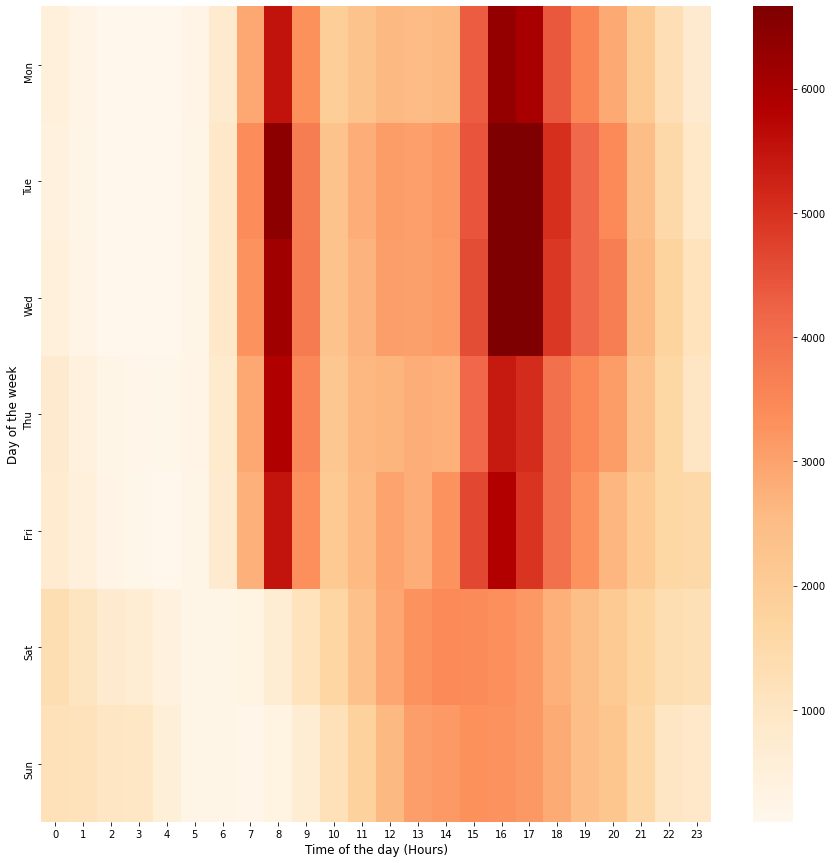

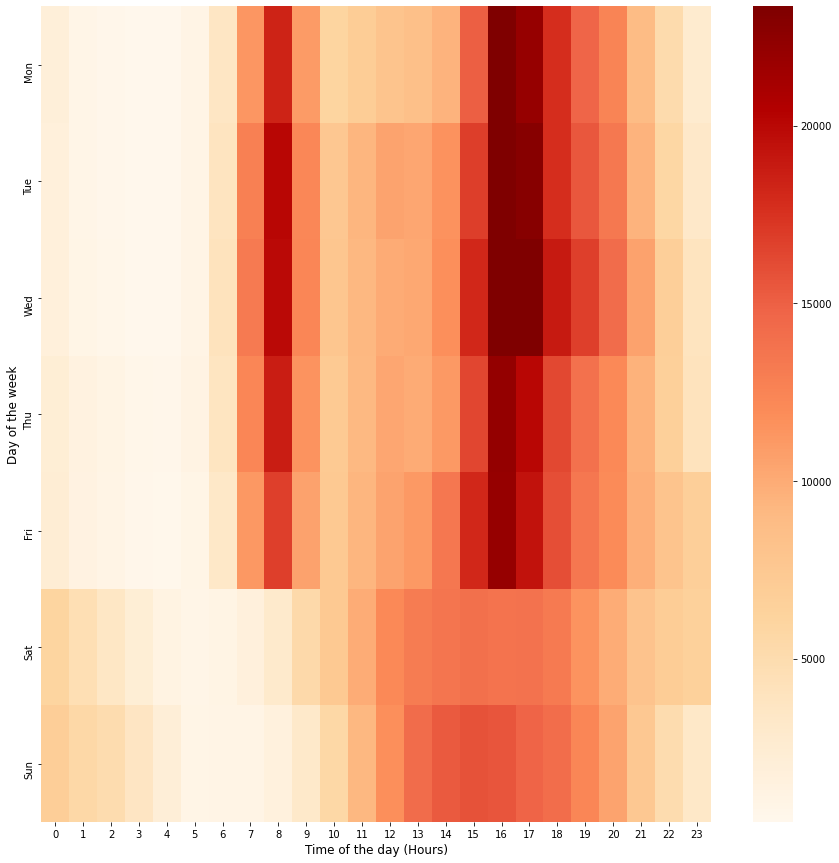

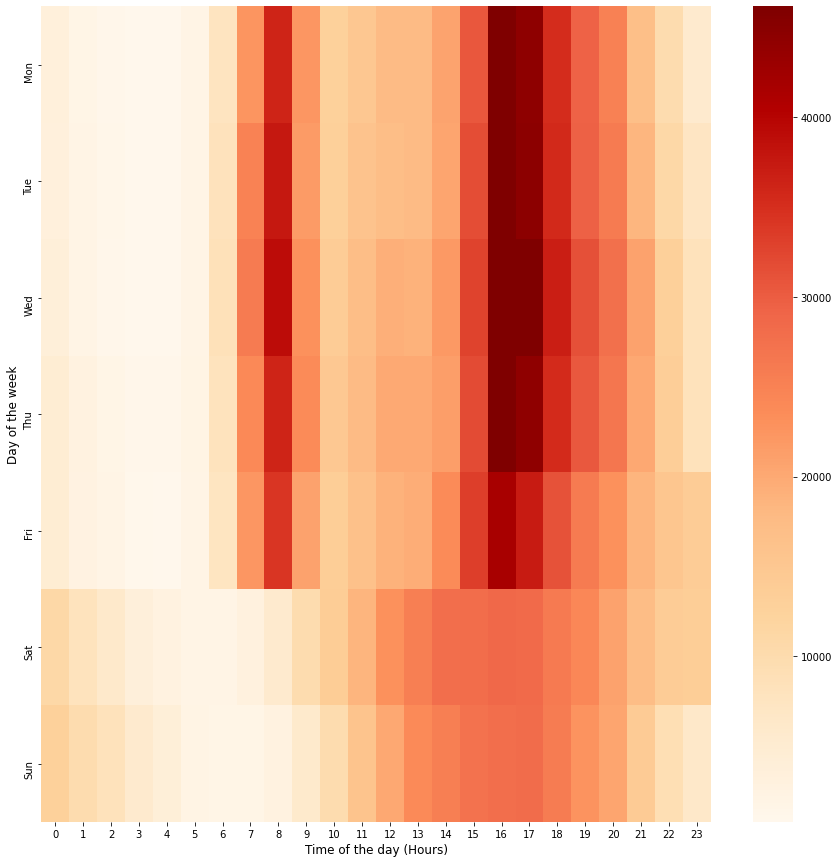

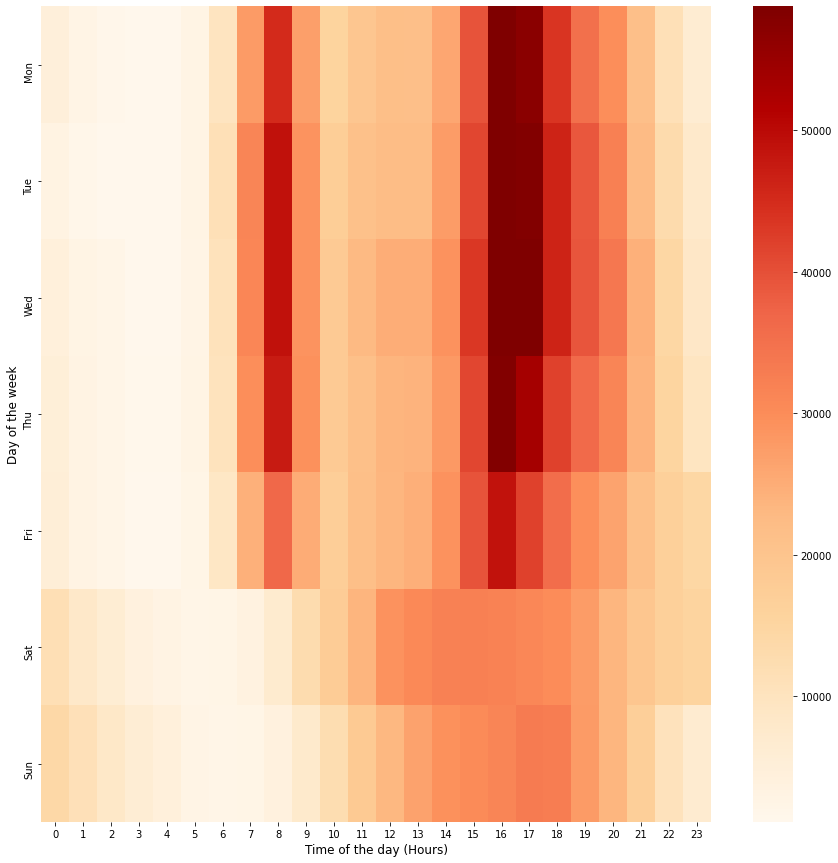

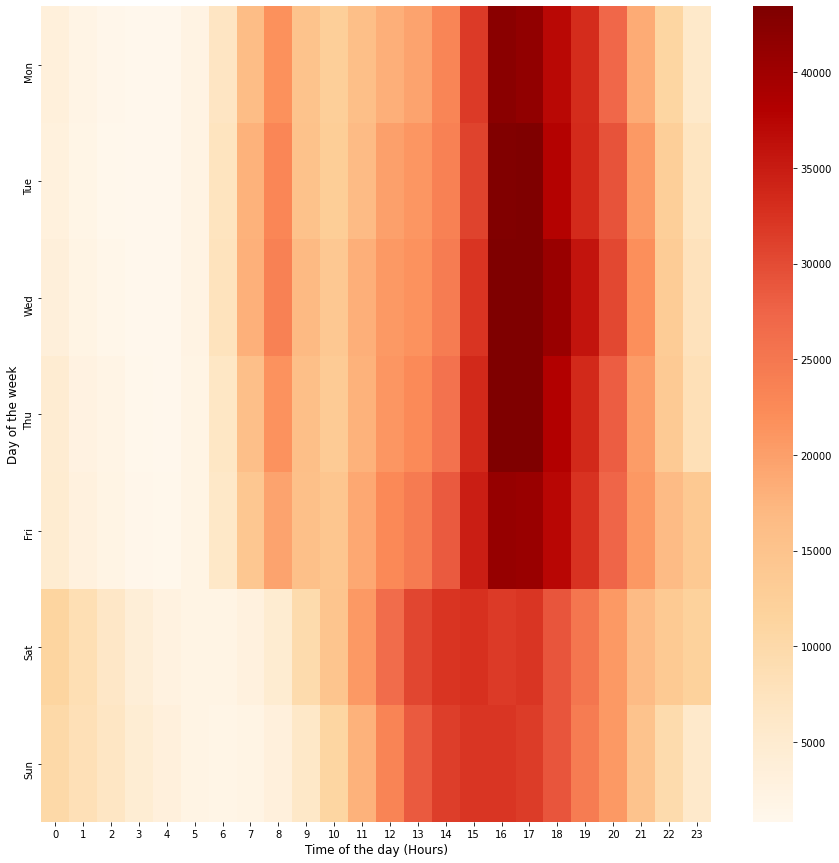

In [183]:
def weekday_heatmap(dataframe, year):
    """
    This function plots the number of trips by weekday and hour of the day.
    """
    weekdays = ["Mon", "Tue","Wed", "Thu", "Fri", "Sat", "Sun"]
    
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    df["hour"] = pd.DatetimeIndex(df['departure']).hour
    df["weekday"] = pd.DatetimeIndex(df['departure']).weekday
    daily_activity = df.groupby(by=['weekday','hour']).count()['departure_name'].unstack()

    # Figure
    fig, ax = plt.subplots(figsize=(15,15))
    sns.heatmap(daily_activity, robust=True, cmap="OrRd", yticklabels=weekdays) # "YlOrBr

    # Labeling Axes
    plt.xlabel("Time of the day (Hours)", fontsize= 12, x = 0.5)
    plt.ylabel("Day of the week", fontsize= 12)


for i in range(5):
    weekday_heatmap(data_list[i],y[i])

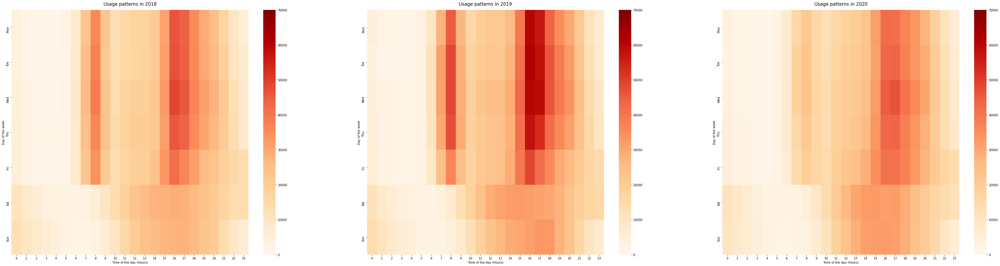

In [187]:
def yearlyHeatmap(dataframe):
    """
    This function plots the number of trips by weekday and hour of the day.
    """
    weekdays = ["Mon", "Tue","Wed", "Thu", "Fri", "Sat", "Sun"]
    
    # Data
    df = dataframe.copy()

    df["hour"] = pd.DatetimeIndex(df['departure']).hour
    df["weekday"] = pd.DatetimeIndex(df['departure']).weekday

    df_2018 = df[df['departure'].dt.year == 2018]
    df_2019 = df[df['departure'].dt.year == 2019]
    df_2020 = df[df['departure'].dt.year == 2020]

    daily_activity_2018 = df_2018.groupby(by=['weekday','hour']).count()['departure_name'].unstack()
    daily_activity_2019 = df_2019.groupby(by=['weekday','hour']).count()['departure_name'].unstack()
    daily_activity_2020 = df_2020.groupby(by=['weekday','hour']).count()['departure_name'].unstack()

    # Figure
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(60,15))

    sns.heatmap(daily_activity_2018, ax=ax1, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)
    sns.heatmap(daily_activity_2019, ax=ax2, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)
    sns.heatmap(daily_activity_2020, ax=ax3, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)

    # Labeling Axes
    ax1.set_title("Usage patterns in 2018", fontsize= 15, pad = 15)    
    ax2.set_title("Usage patterns in 2019", fontsize= 15, pad = 15)
    ax3.set_title("Usage patterns in 2020", fontsize= 15,pad = 15)

    ax1.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")
    ax2.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")
    ax3.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")


yearlyHeatmap(dataframe)

In [212]:
def topFiveDepartureStations(dataframe,year):
    """
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

top_5_departure = year_2016['departure_name'].value_counts()[:5]
top_5_departure.columns = ['station', "number_of_departure"]

top_5_departure

Kamppi (M)          16837
Töölönlahdenkatu    16278
Unioninkatu         14958
Itämerentori        14939
Apollonkatu         13458
Name: departure_name, dtype: int64

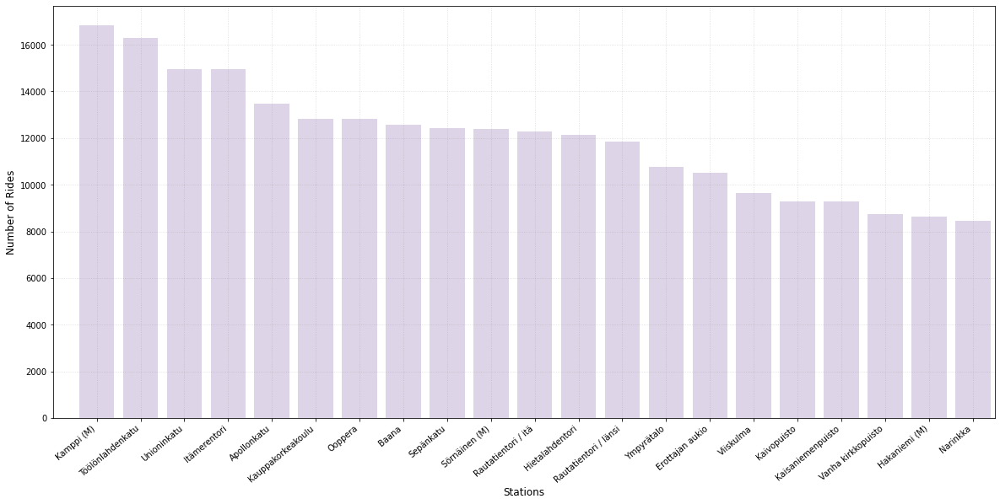

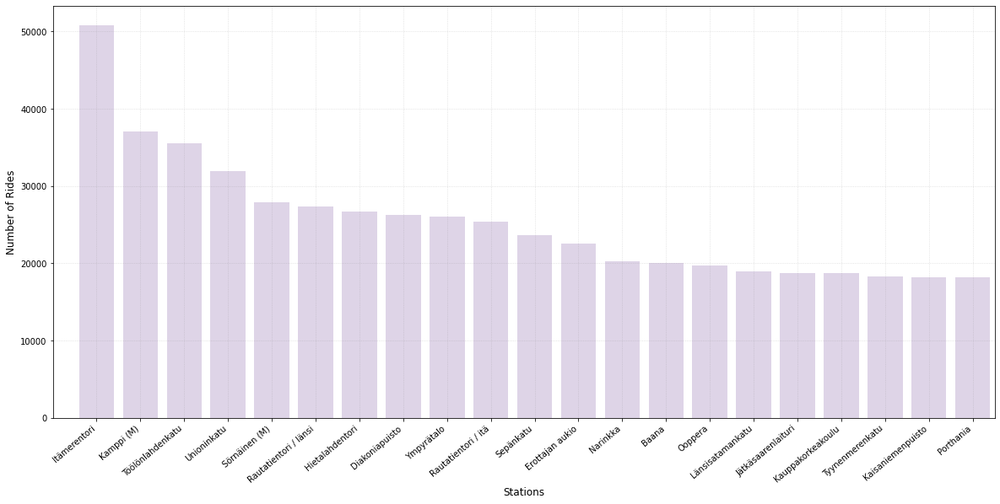

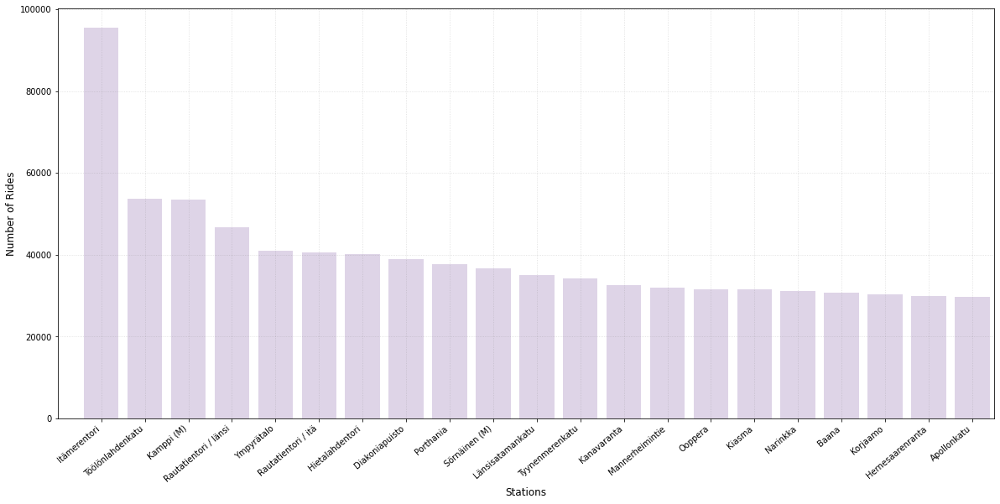

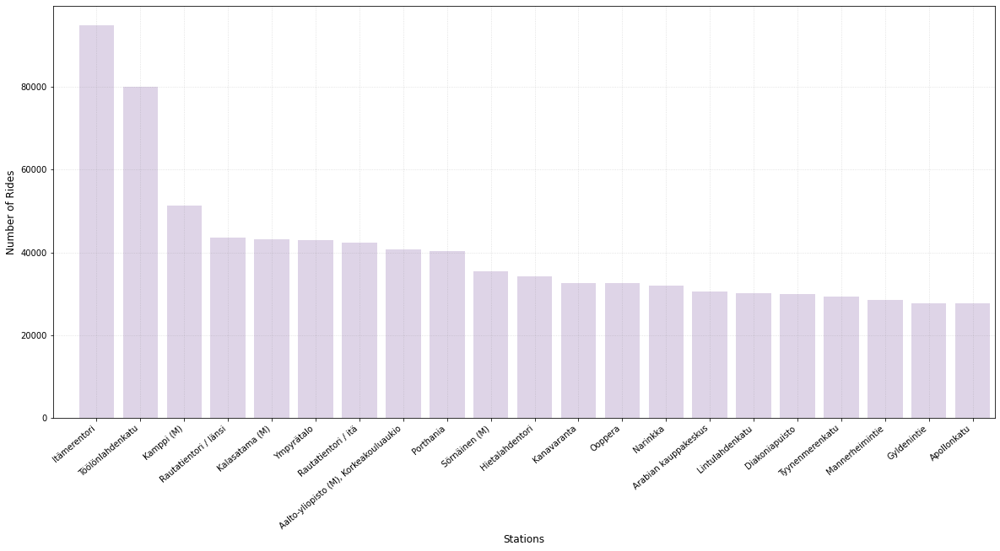

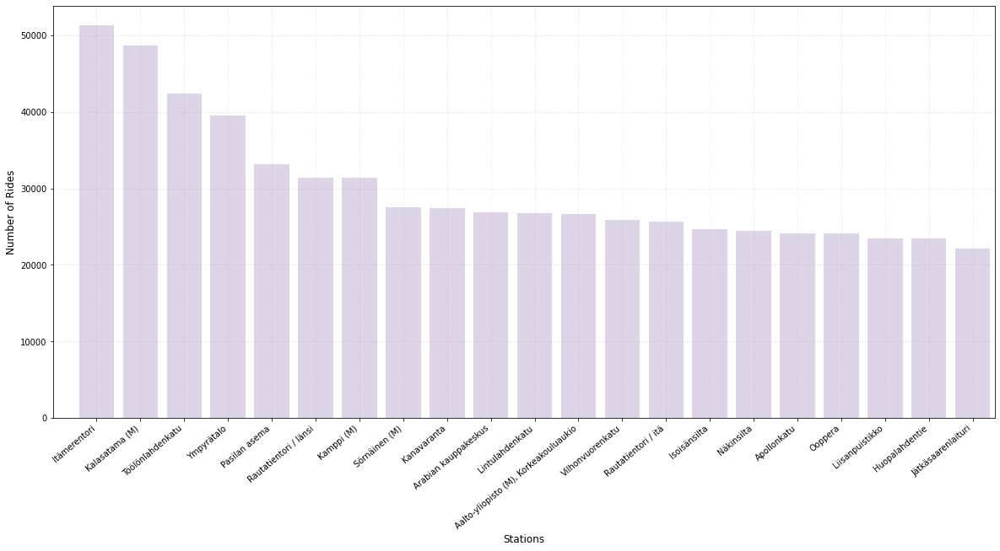

In [190]:
def topDepartureStations(dataframe,year):
    """
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

    # Figure
    fig = plt.figure(figsize=(20,9))
    ax = sns.countplot(x="departure_name", color = 'tab:purple',alpha=0.3, data=df, order = df['departure_name'].value_counts().index)

    # Labeling Axes
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    plt.xlabel("Stations", fontsize= 12, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)
    plt.xlim(-1,20.5)

    # Adding Grid
    plt.grid(linestyle=":", color='grey',alpha=0.3)

for i in range(5):
    topDepartureStations(data_list[i],y[i])

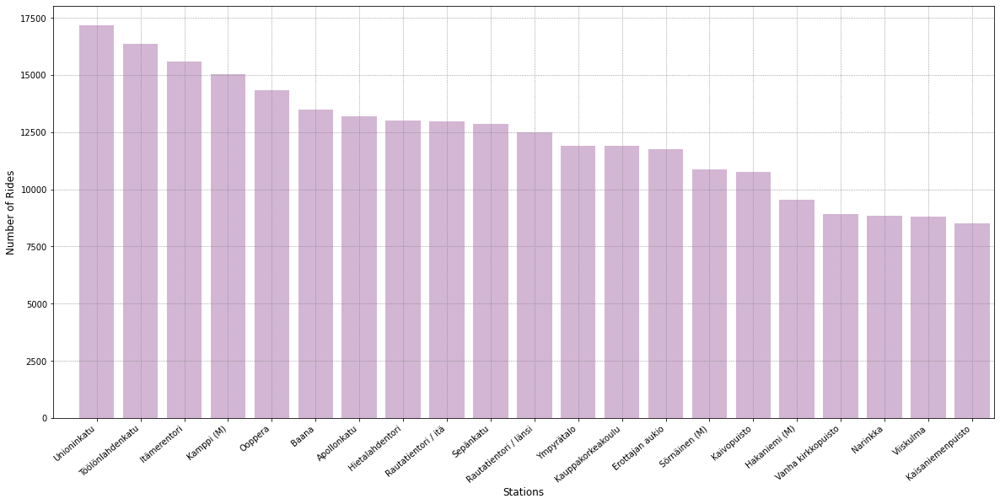

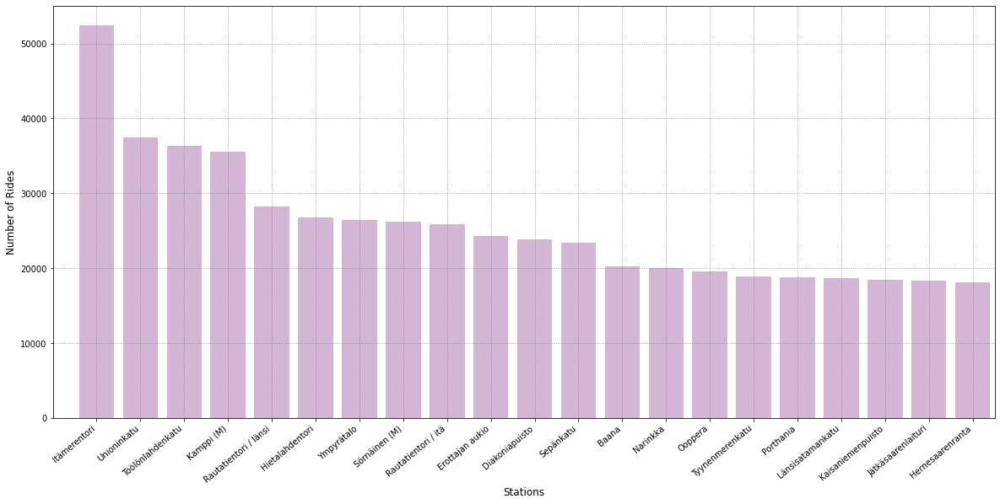

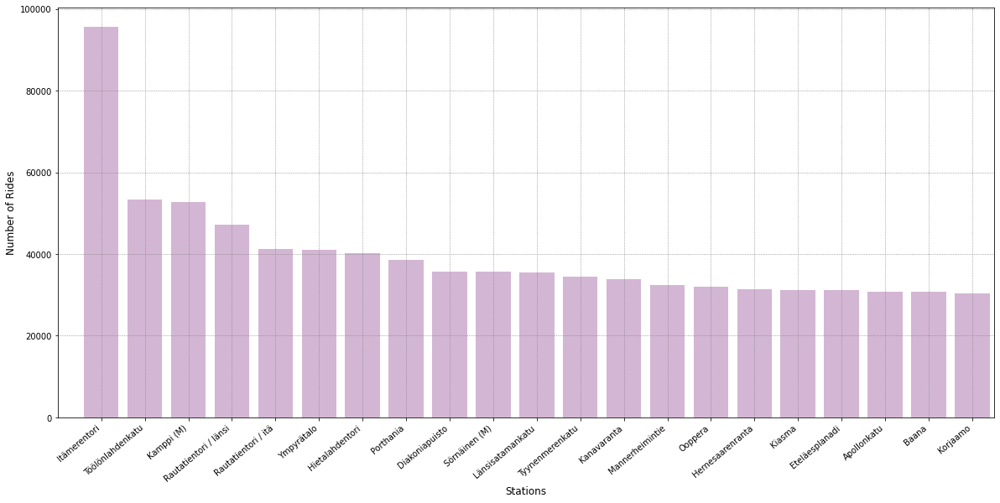

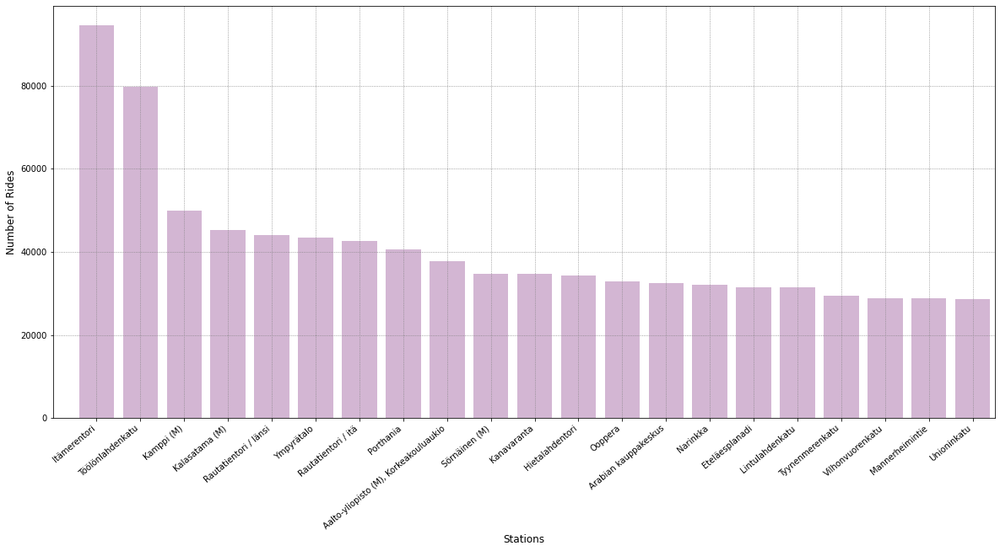

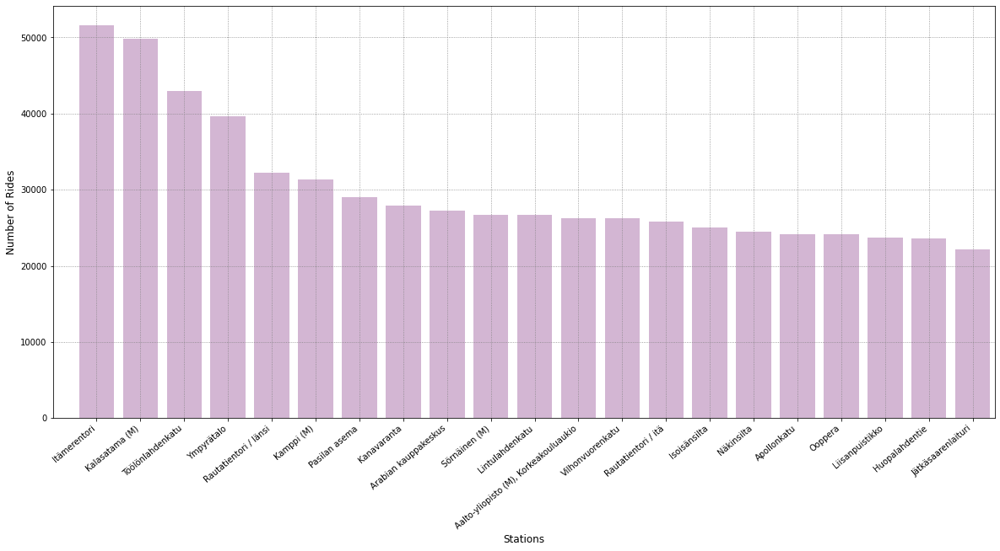

In [192]:
def topReturnStations(dataframe,year):
    """
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

    # Figure
    fig = plt.figure(figsize=(20,9))
    ax = sns.countplot(x="return_name", color = 'purple',alpha=0.3, data=df, order = df['return_name'].value_counts().index)

    # Labeling Axes
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    plt.xlabel("Stations", fontsize= 12, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)
    plt.xlim(-1,20.5)

    # Adding Grid
    plt.grid(linestyle=":", color='grey')

for i in range(5):
    topReturnStations(data_list[i],y[i])

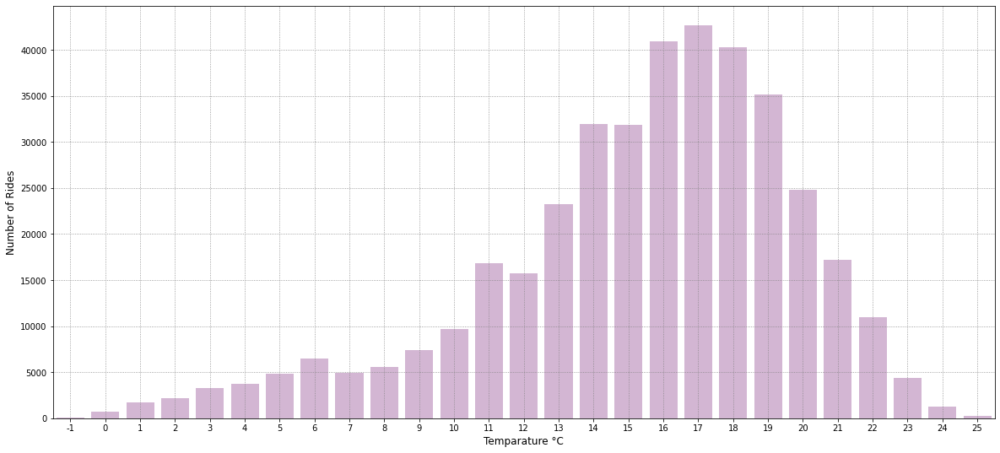

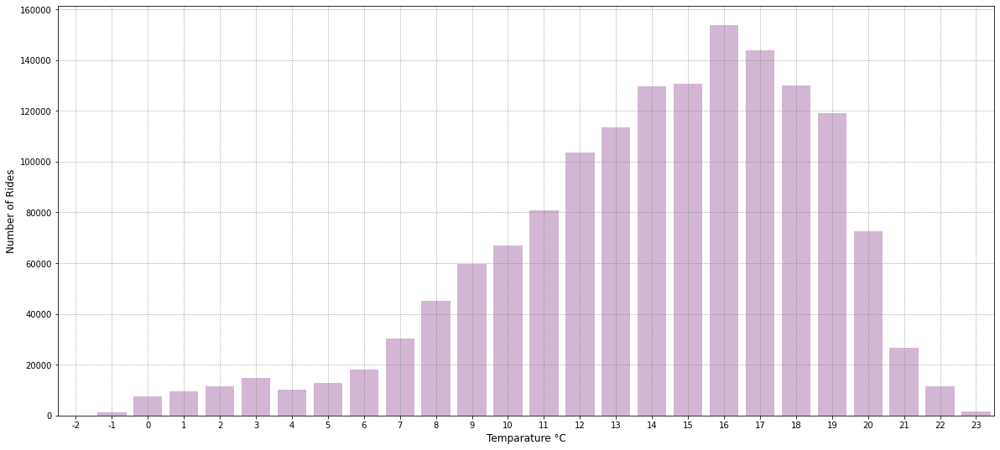

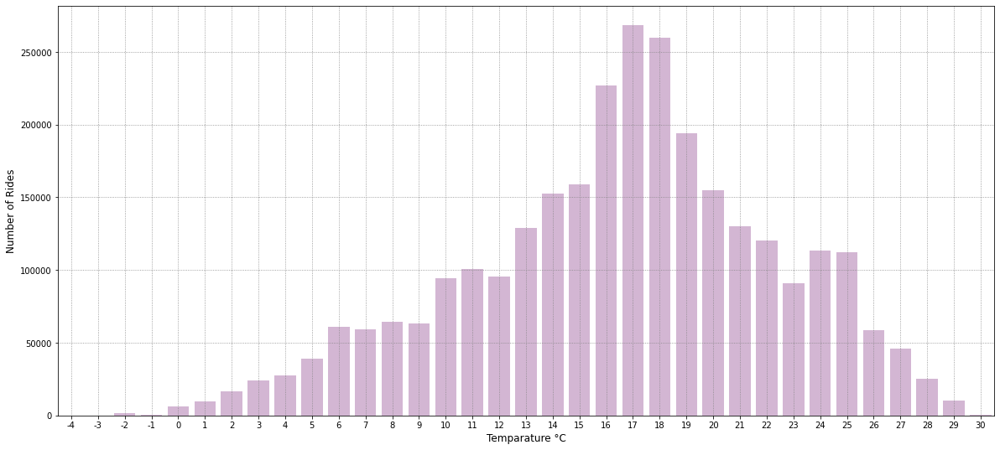

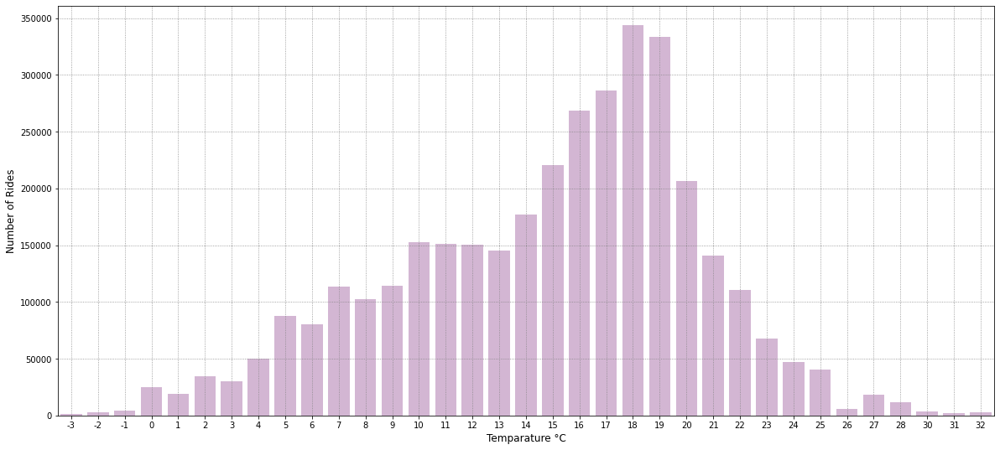

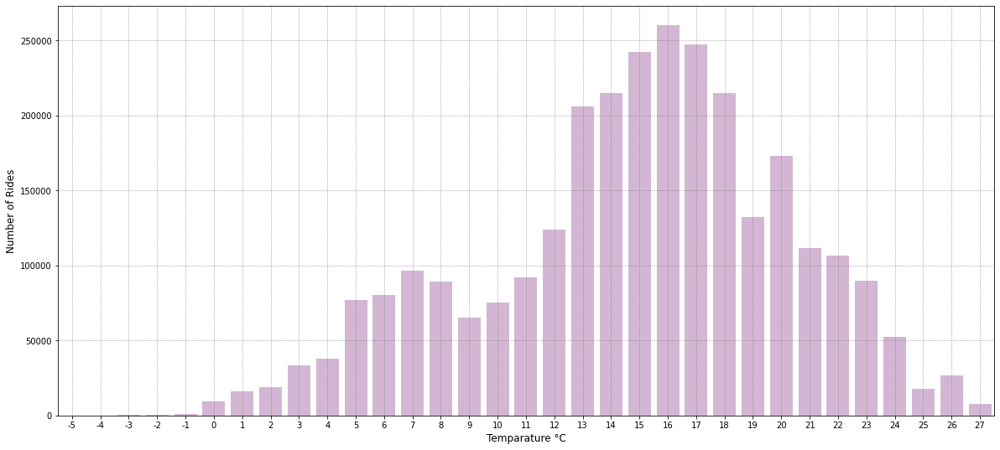

In [194]:
def temperatureHist(dataframe):
    """
    """
    # Data
    df = dataframe.copy()
    df.dropna(inplace=True)
    df["temperature"] = df["temperature"].astype(int)
    
    # Figure
    fig, ax = plt.subplots(figsize=(20,9))
    ax = sns.countplot(x="temperature",data=df, color = 'purple', alpha=0.3)

    # Labels
    ax.set_xlabel("Temparature °C", fontsize= 12, x = 0.5)
    ax.set_ylabel("Number of Rides", fontsize= 12)
    plt.ticklabel_format(style='plain', axis='y')

    # Grid
    ax.grid(linestyle=":", color='grey')

for i in data_list:
    temperatureHist(i)

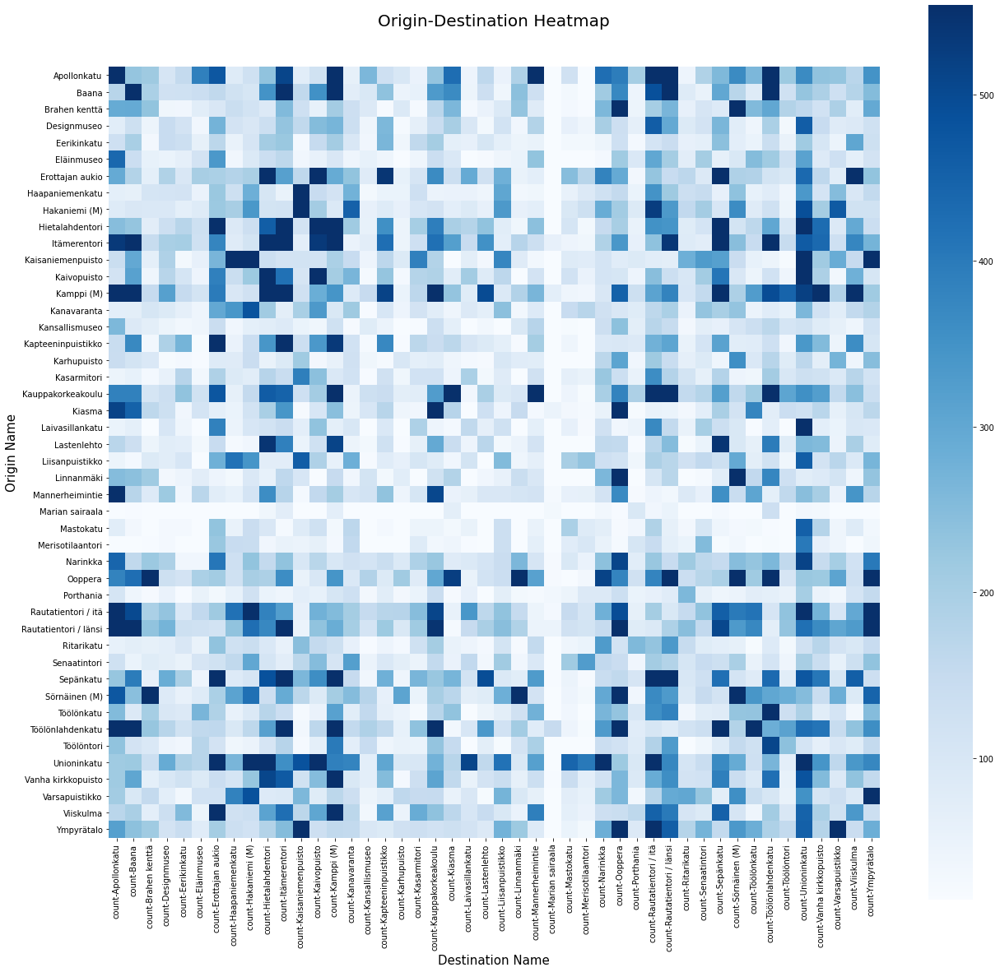

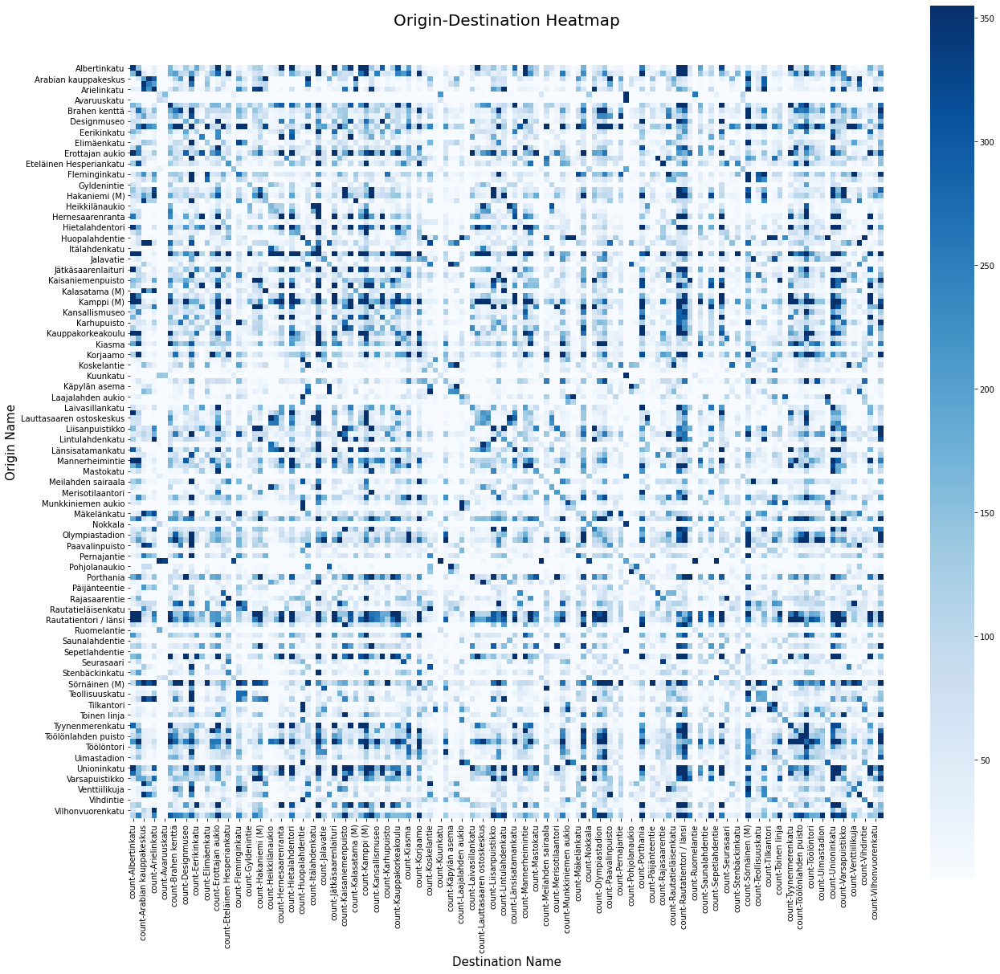

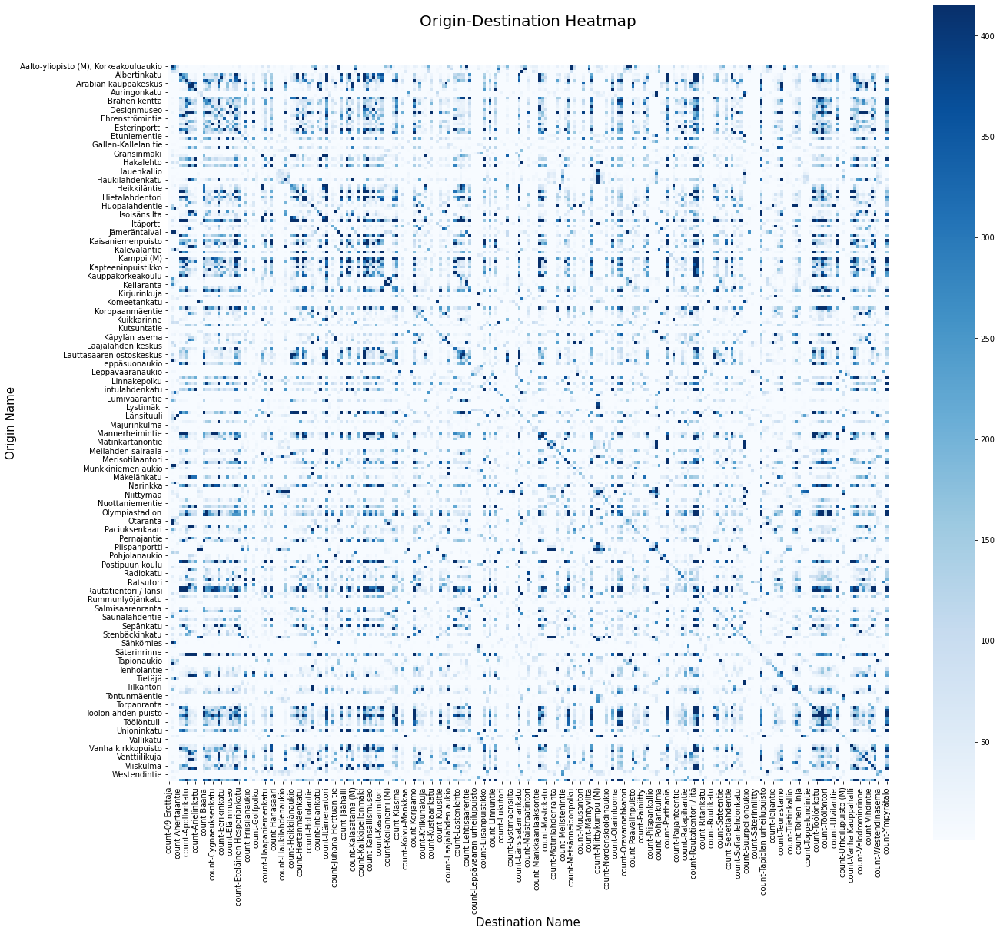

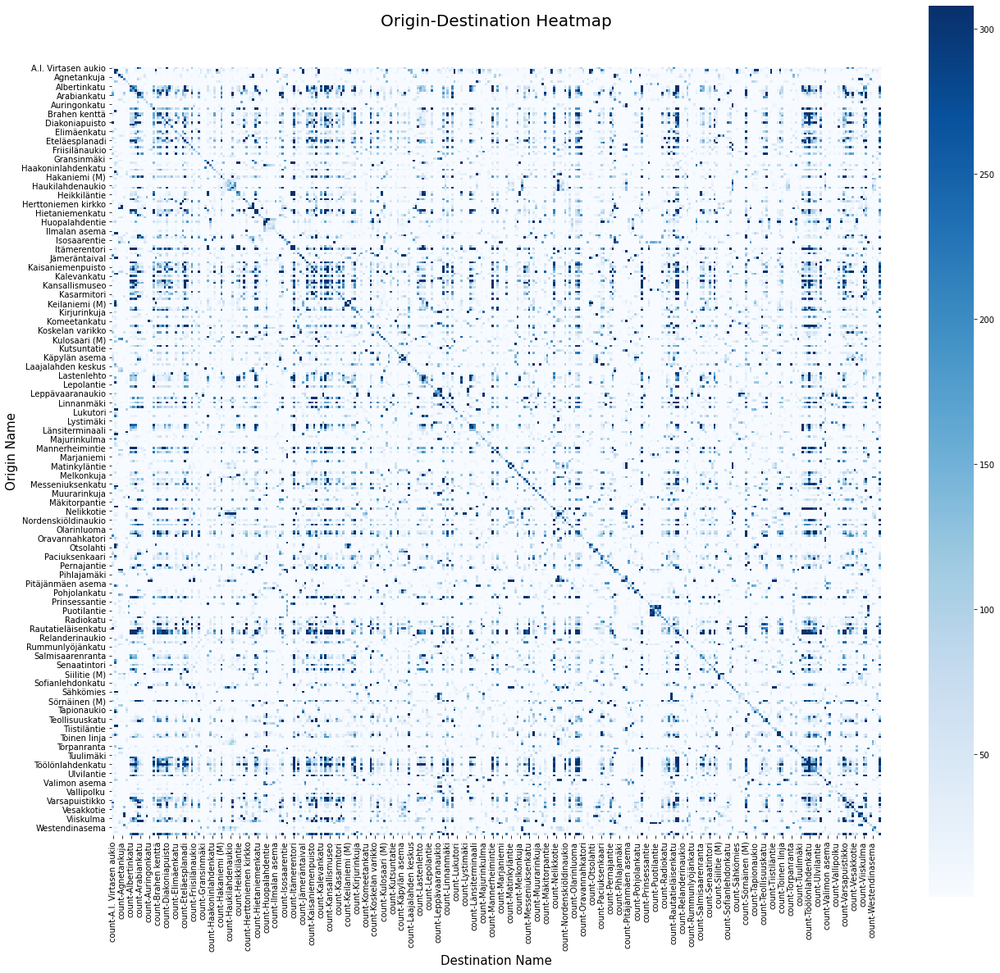

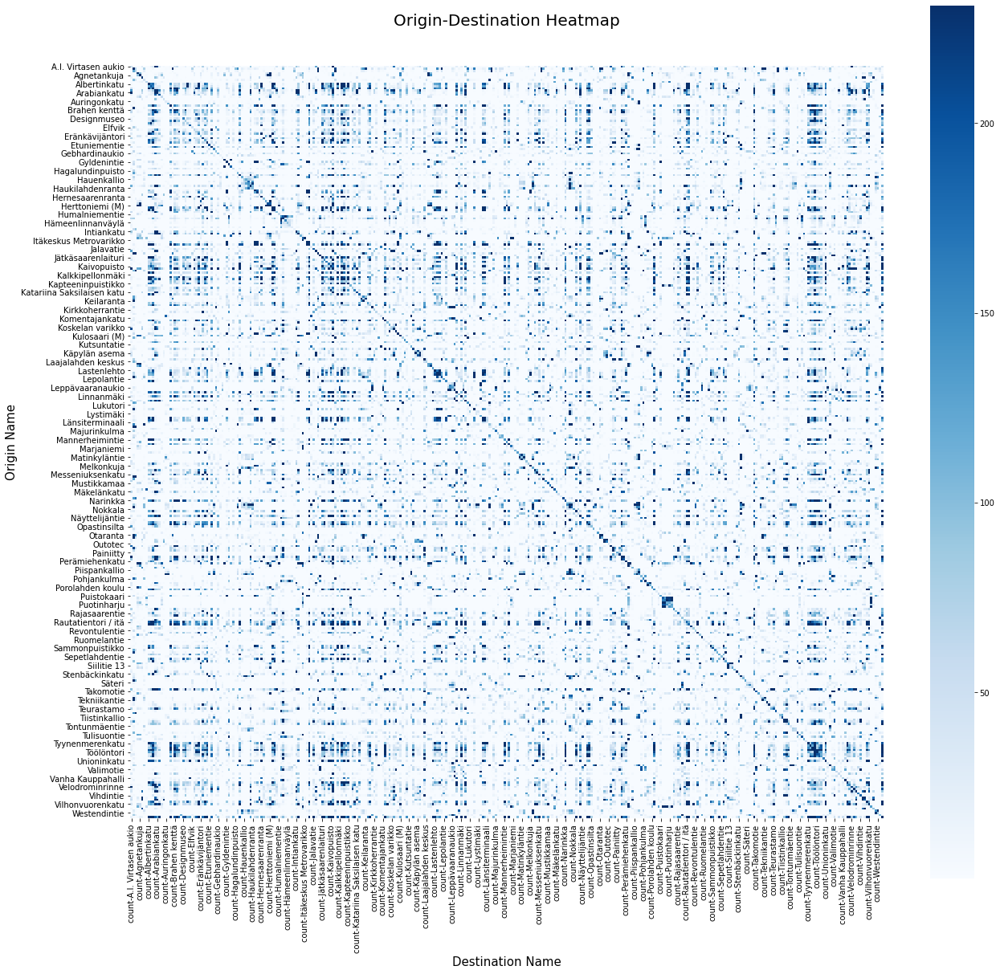

In [198]:
def odHeatmap(dataframe, year):
    """
    This function Prints Origin-Destination heatmap for a given year.
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    
    dff = df.groupby(['departure_name', 'return_name']).size()
    dff = dff.sort_values(ascending=False)
    dff = dff.reset_index()
    dff.columns.values[2] = "count"
    #dff = dff[:50] 

    # Color scale for heatmap
    min_value = dff["count"].quantile(0.05)
    max_value = dff["count"].quantile(0.95)

    # Pivot
    dff = dff.pivot_table(index='departure_name', columns="return_name", fill_value=0)
    dff.sort_index(level=0, ascending=True, inplace=True)

    # Figure
    fig, ax = plt.subplots(figsize=(21,20))
    sns.heatmap(dff,vmin=min_value,vmax=max_value, cmap="Blues",square=True)
    
    # Labeling
    ax.set_title('Origin-Destination Heatmap', fontdict={"fontsize":20}, pad = 50)
    ax.set_xlabel("Destination Name", fontsize= 15, x = 0.5)
    ax.set_ylabel("Origin Name", fontsize= 15)

for i in range(5):
    odHeatmap(data_list[i],y[i])

In [204]:

def mapPlot(dataframe, year = 2020):
    """
    This function prints an interactive bubble plot by destination locations for a given year.
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    #df = df[:1000]
    df.dropna(inplace=True)
    df['freq'] = df.groupby('departure_name')['departure_name'].transform('count')
    #print(df.isna().sum())
    df["name"] = df["departure_name"]
    df = df[["name", "freq"]]
    df = df.drop_duplicates(subset=['name'])
    freq_dict = dict(zip(df.name, df.freq))

    df_stations = pd.read_csv("/Users/thi/Documents/GitHub/helsinki-city-bikes/data/downloaded_data/station_coordinates.csv", index_col=False)
    df_stations = df_stations[df_stations["latitude"]<=60.254011]
    #print(df_stations.head())
    df_stations['freq']= df_stations['name'].map(freq_dict)
    #print(df_stations.head(), df_stations.isna().sum(), len(df_stations))
    df_stations["freq_adj"] = df_stations['freq']/(df_stations['freq'].median()/3)
    df_stations.fillna(1, inplace=True)
    df_stations.dropna(inplace=True)

    # Map
    hel_map = folium.Map([60.1975594, 24.9320720], zoom_start=12)
    folium.TileLayer('cartodbdark_matter').add_to(hel_map)


    for index, row in df_stations.iterrows():
        folium.CircleMarker([row['latitude'],row['longitude']],
                        radius=row["freq_adj"],
                        popup=row['freq'],
                        color="#eab544",
                        fill_color="#eab544", # divvy color
                    ).add_to(hel_map)

    display(hel_map)
    
# If the function call is commented its for performance reasons
mapPlot(dataframe)

TypeError: 'tuple' object is not callable

In [206]:
def heatMapPlot(dataframe, year = 2020):
    """
    This function prints an interactive heatmap by destination locations for a given year.
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

    df.dropna(inplace=True)
    df['freq'] = df.groupby('departure_name')['departure_name'].transform('count')
    

    # Map
    hel_map = folium.Map([60.1975594, 24.9320720], zoom_start=12)
    folium.TileLayer('cartodbdark_matter').add_to(hel_map)

    stationArr = df[['departure_latitude', 'departure_longitude']].to_numpy()
    hel_map.add_child(plugins.HeatMap(stationArr, radius=15))

    display(hel_map)
    
# function call is commented for performance reasons
heatMapPlot(dataframe)


TypeError: 'tuple' object is not callable

## Network Analysis

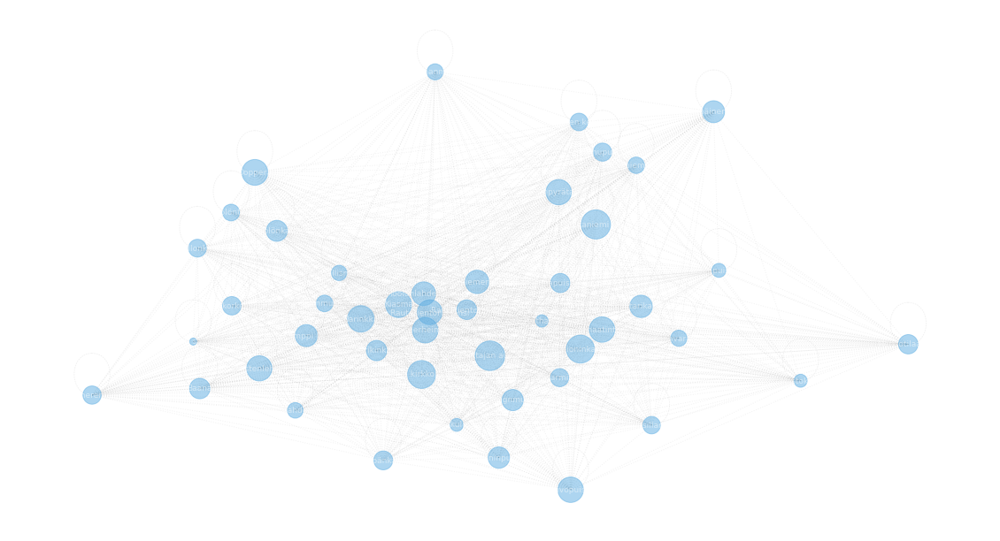

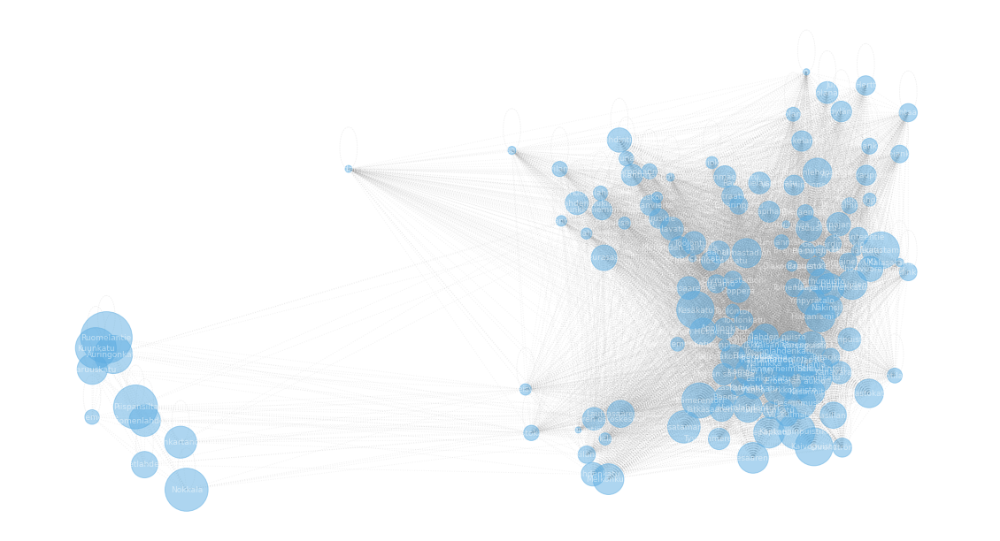

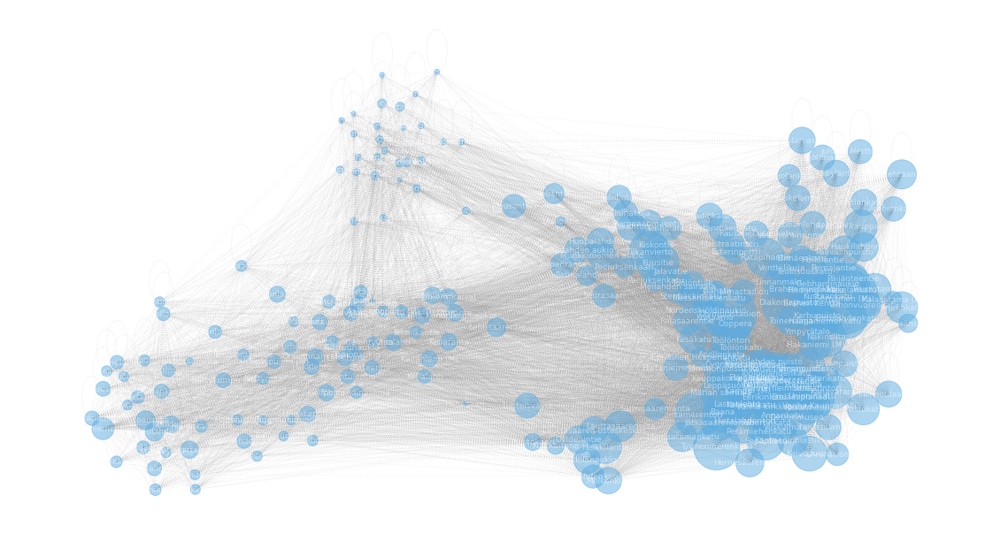

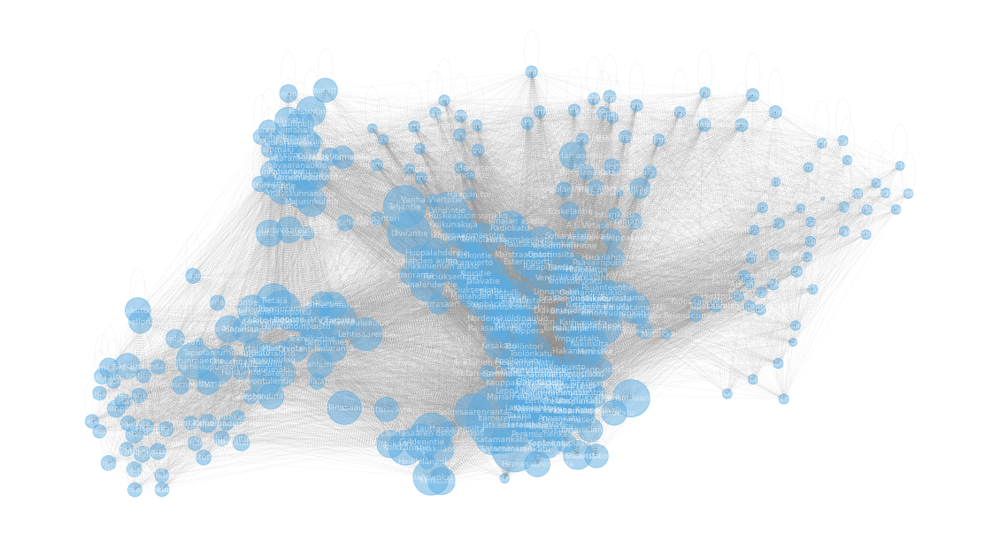

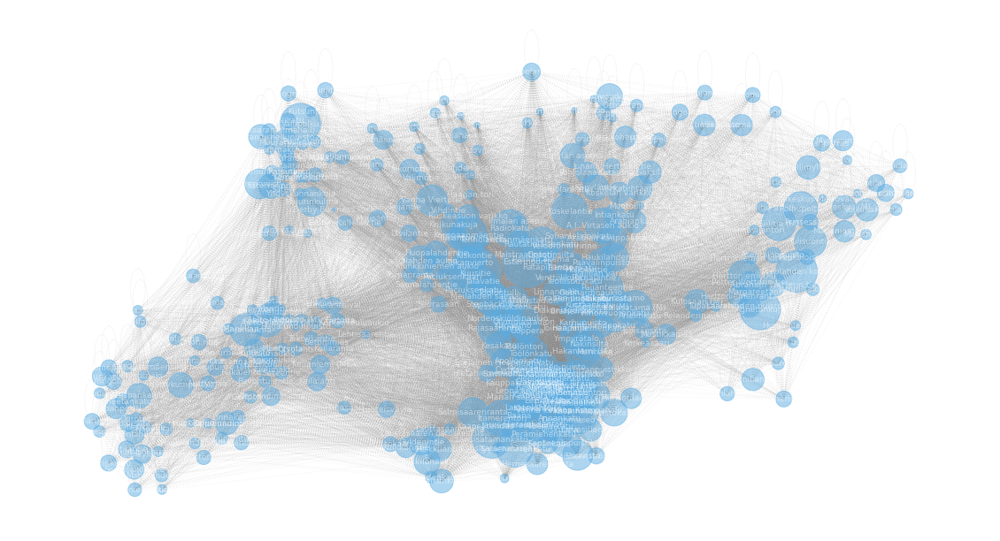

In [186]:
# Covid network
def bikeNetwork(dataframe, year):
    """
    This function plots the City bike network with node sizes illustrating station popularity.
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    df.dropna(inplace=True)
    #print(df.isna().sum())
    
    # Graphs
    G = nx.Graph()
    G = nx.from_pandas_edgelist(df, 'departure_name', 'return_name', edge_attr=['duration','distance'])


    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    # Positions
    stations  = pd.read_csv("/Users/thi/Documents/GitHub/helsinki-city-bikes/data/downloaded_data/station_coordinates.csv")
    stations.set_index('name',inplace=True)
    stations["pos"] = list(zip(stations["longitude"].astype(float), stations["latitude"].astype(float)))
    pos = stations.to_dict()['pos']

    # Map "pos" atribute to nodes from pos dict
    for node, position in pos.items():
        try:
            G.nodes[node]['pos'] = position
        except KeyError:
            pass
    # Draw
    nx.draw_networkx_nodes(G=G,pos=G.nodes.data('pos'), node_color=BLUE, alpha=0.5, node_size= (df['departure_name'].value_counts()/15).tolist())
    nx.draw_networkx_edges(G=G,pos=G.nodes.data('pos'), edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='white',alpha=0.5)
    ax.axis('off')

    return G


y16 = bikeNetwork(year_2016,2016)
y17 = bikeNetwork(year_2017,2017)
y18 = bikeNetwork(year_2018,2018)
y19 = bikeNetwork(year_2019,2019)
y20 = bikeNetwork(year_2020,2020)

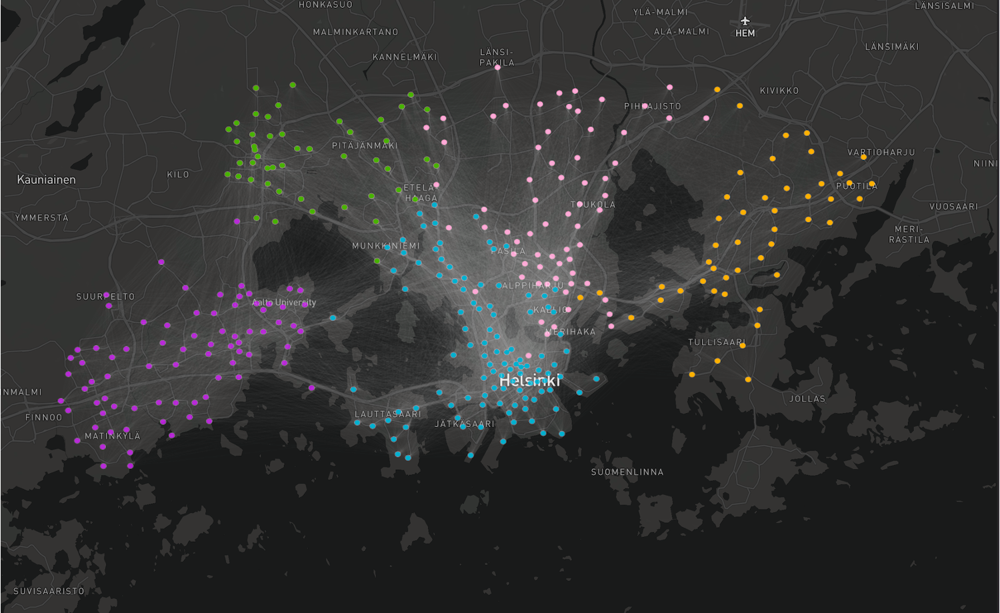

In [8]:
from IPython.display import Image
Image(filename='/Users/thi/Documents/Documents - autobahn/OneDrive - fs-students.de/1.School/c.__Introduction_to_Data_Analytics_in_Business /Network Analysis/network_cover.png')

In [22]:
data_list = [year_2016,year_2017,year_2018,year_2019,year_2020]
network_list = [y16,y17,y18,y19,y20]

for i in range(5):
    print(f"year {y[i]} : {nx.info(network_list[i])}")
# summary = pd.DataFrame()


year 2016 : Graph with 46 nodes and 1081 edges
year 2017 : Graph with 142 nodes and 8589 edges
year 2018 : Graph with 246 nodes and 17068 edges
year 2019 : Graph with 340 nodes and 27708 edges
year 2020 : Graph with 347 nodes and 29604 edges


## Basic Network Information

In [10]:
""" 
Network stats that need to review:
1. network density:
    Return the density of a graph.
    The density for undirected graphs is:
    d = {2m} / {n(n-1)}

    and for directed graphs is:
    d = {m} / {n(n-1)},
    where n is the number of nodes and m is the number of edges in G.

2. Transitivity (G):
    Compute graph transitivity, the fraction of all possible triangles present in G.

    Possible triangles are identified by the number of “triads” (two edges with a shared vertex).

    The transitivity is: T = 3(triangles) / (triads)

    Parameters
    Ggraph

3. betweenness_centrality:
    Compute the shortest-path betweenness centrality for nodes.

    Betweenness centrality of a node v is the sum of the fraction of all-pairs 
    shortest paths that pass through v:
    where V is the set of nodes, \sigma(s, t) is the number of shortest (s, t)-paths
    , and \sigma(s, t|v) is the number of those paths passing through some node v other than s, t. 
    If s = t, \sigma(s, t) = 1, and if v \in {s, t}, \sigma(s, t|v) = 0 [2].

4. Compute the eigenvector centrality for the graph G.

    Eigenvector centrality computes the centrality 
    for a node based on the centrality of its neighbors. 
    The eigenvector centrality for node i is:
        Ax = lambda.x
    where A is the adjacency matrix of the graph G with eigenvalue \lambda. 
    By virtue of the Perron–Frobenius theorem, there is a unique and positive solution if 
    lambda is the largest eigenvalue associated with the eigenvector of the adjacency matrix
"""

' \nNetwork stats that need to review:\n1. network density:\n    Return the density of a graph.\n    The density for undirected graphs is:\n    d = {2m} / {n(n-1)}\n\n    and for directed graphs is:\n    d = {m} / {n(n-1)},\n    where n is the number of nodes and m is the number of edges in G.\n\n2. Transitivity (G):\n    Compute graph transitivity, the fraction of all possible triangles present in G.\n\n    Possible triangles are identified by the number of “triads” (two edges with a shared vertex).\n\n    The transitivity is: T = 3(triangles) / (triads)\n\n    Parameters\n    Ggraph\n\n3. betweenness_centrality:\n    Compute the shortest-path betweenness centrality for nodes.\n\n    Betweenness centrality of a node v is the sum of the fraction of all-pairs \n    shortest paths that pass through v:\n    where V is the set of nodes, \\sigma(s, t) is the number of shortest (s, t)-paths\n    , and \\sigma(s, t|v) is the number of those paths passing through some node v other than s, t. \

## Key metrics:
- Density
- Transitivity
- betweeness centrality
- eigenvector centrality
- centralityDegreeInteractive
- centralityDegreeDist

In [11]:
betweenness_dict = nx.betweenness_centrality(y19)
betweenness_dict = sorted(betweenness_dict.items(), key=itemgetter(1),reverse=True)
betweenness_dict[:5]

[('Haukilahdenkatu', 0.04401298372663504),
 ('Kaisaniemenpuisto', 0.0208599313817226),
 ('Aalto-yliopisto (M), Korkeakouluaukio', 0.007402192943142119),
 ('Lauttasaaren ostoskeskus', 0.0066372716475881655),
 ('Lehtisaarentie', 0.006031677765566405)]

In [12]:
def networkStats(G):
    """
    This function prints the basic properties of the City bike network.
    """
    print(nx.info(G))
    density = nx.density(G)
    print("Network density:", density)
    triadic_closure = nx.transitivity(G)
    print("Triadic closure:", triadic_closure)

    degree_dict = dict(G.degree(G.nodes()))
    nx.set_node_attributes(G, degree_dict, 'degree')
    #print(G.nodes['Kamppi (M)'])

    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    print("\nTop 5 nodes by degree:\n")
    for d in sorted_degree[:5]:
        print(d)

    betweenness_dict = nx.betweenness_centrality(G) # Compute betweenness centrality
    eigenvector_dict = nx.eigenvector_centrality(G) # Compute eigenvector centrality

    sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

    print("\nTop 5 nodes by betweenness centrality:\n")
    for b in sorted_betweenness[:5]:
        print(b)

networkStats(y16)
# networkStats(y17)
# networkStats(y18)
# networkStats(y19)
# networkStats(y20)

Graph with 46 nodes and 1081 edges
Network density: 1.0444444444444445
Triadic closure: 1.0

Top 5 nodes by degree:

('Erottajan aukio', 47)
('Hakaniemi (M)', 47)
('Unioninkatu', 47)
('Vanha kirkkopuisto', 47)
('Narinkka', 47)

Top 5 nodes by betweenness centrality:

('Erottajan aukio', 0.0)
('Hakaniemi (M)', 0.0)
('Unioninkatu', 0.0)
('Vanha kirkkopuisto', 0.0)
('Narinkka', 0.0)


In [13]:
# network desity is decreasing as the growth of nodes
for i in range(5):
    print(f"year {y[i]} : {nx.density(network_list[i])}")


year 2016 : 1.0444444444444445
year 2017 : 0.8579562481270603
year 2018 : 0.5663846026215364
year 2019 : 0.48079125455491933
year 2020 : 0.49314520830904035


In [14]:
# network desity is decreasing as the growth of nodes
for i in range(5):
    print(f"year {y[i]} : {nx.transitivity(network_list[i])}")

year 2016 : 1.0
year 2017 : 0.9643450815161377
year 2018 : 0.7966609717351557
year 2019 : 0.7424960967280716
year 2020 : 0.7490986589530844


In [15]:
# top nodes by degree
def networkdegree(G):
    degree_dict = dict(G.degree(G.nodes()))
    nx.set_node_attributes(G, degree_dict, 'degree')
    #print(G.nodes['Kamppi (M)'])

    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    print("\nTop 5 nodes by degree:\n")
    for d in sorted_degree[:5]:
        print(d)

for i in range(5):
    print(f"year {y[i]} : {networkdegree(network_list[i])}")


Top 5 nodes by degree:

('Erottajan aukio', 47)
('Hakaniemi (M)', 47)
('Unioninkatu', 47)
('Vanha kirkkopuisto', 47)
('Narinkka', 47)
year 2016 : None

Top 5 nodes by degree:

('Itämerentori', 135)
('Kesäkatu', 133)
('Erottajan aukio', 133)
('Rautatientori / itä', 133)
('Eläinmuseo', 133)
year 2017 : None

Top 5 nodes by degree:

('Haukilahdenkatu', 215)
('Lauttasaaren ostoskeskus', 212)
('Laajalahden aukio', 212)
('Lehtisaarentie', 212)
('Munkkiniemen aukio', 207)
year 2018 : None

Top 5 nodes by degree:

('Haukilahdenkatu', 308)
('Kaisaniemenpuisto', 275)
('Tilkanvierto', 258)
('Paciuksenkaari', 255)
('Munkkiniemen aukio', 254)
year 2019 : None

Top 5 nodes by degree:

('Haukilahdenkatu', 312)
('Paciuksenkaari', 272)
('Huopalahdentie', 267)
('Laajalahden aukio', 262)
('Munkkiniemen aukio', 262)
year 2020 : None


In [16]:
df.columns

Index(['departure', 'return', 'departure_id', 'departure_name', 'return_id',
       'return_name', 'distance', 'duration', 'speed', 'departure_latitude',
       'departure_longitude', 'return_latitude', 'return_longitude',
       'temperature', 'Month'],
      dtype='object')

In [27]:
def mapPlot(dataframe, year):
    """
    This function prints an interactive bubble plot by destination locations for a given year.
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    #df = df[:1000]
    df.dropna(inplace=True)
    df['freq'] = df.groupby('departure_name')['departure_name'].transform('count')
    #print(df.isna().sum())
    df["name"] = df["departure_name"]
    df = df[["name", "freq"]]
    df = df.drop_duplicates(subset=['name'])
    freq_dict = dict(zip(df.name, df.freq))

    df_stations = pd.read_csv("/Users/thi/Documents/GitHub/helsinki-city-bikes/data/downloaded_data/station_coordinates.csv")
    df_stations = df_stations[df_stations["latitude"]<=60.254011]
    #print(df_stations.head())
    df_stations['freq']= df_stations['name'].map(freq_dict)
    #print(df_stations.head(), df_stations.isna().sum(), len(df_stations))
    df_stations["freq_adj"] = df_stations['freq']/(df_stations['freq'].median()/3)
    df_stations.fillna(1, inplace=True)
    df_stations.dropna(inplace=True)

    # Map
    hel_map = folium.Map([60.1975594, 24.9320720], zoom_start=12)
    folium.TileLayer('cartodbdark_matter').add_to(hel_map)

    for index, row in df_stations.iterrows():
        folium.CircleMarker([row['latitude'],row['longitude']],
                        radius=row["freq_adj"],
                        popup=row['freq'],
                        color="#eab544",
                        fill_color="#eab544",
                    ).add_to(hel_map)

    display(hel_map)
    
# function call is commented for performance reasons
for i in range(5):
    mapPlot(data_list[i],y[i])

# Degree Centrality

Degree centrality is the most simple centrality measure to understand and compute. "Degree" of a node refers to the number of nodes that a given node is connected to. Within the context of city bikes, this refers to the number of bike stations that users have travelled to from the target station. As we can see in the graph below stations located in central Helsinki have a higher number of connections. Closer to the periphery of the network the degree of the nodes gradually decreases.

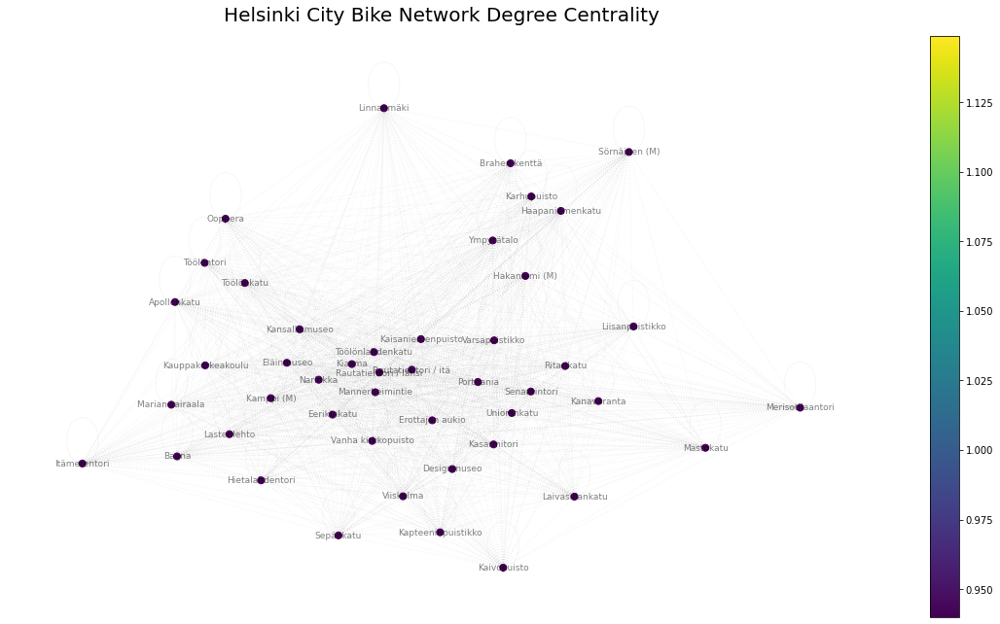

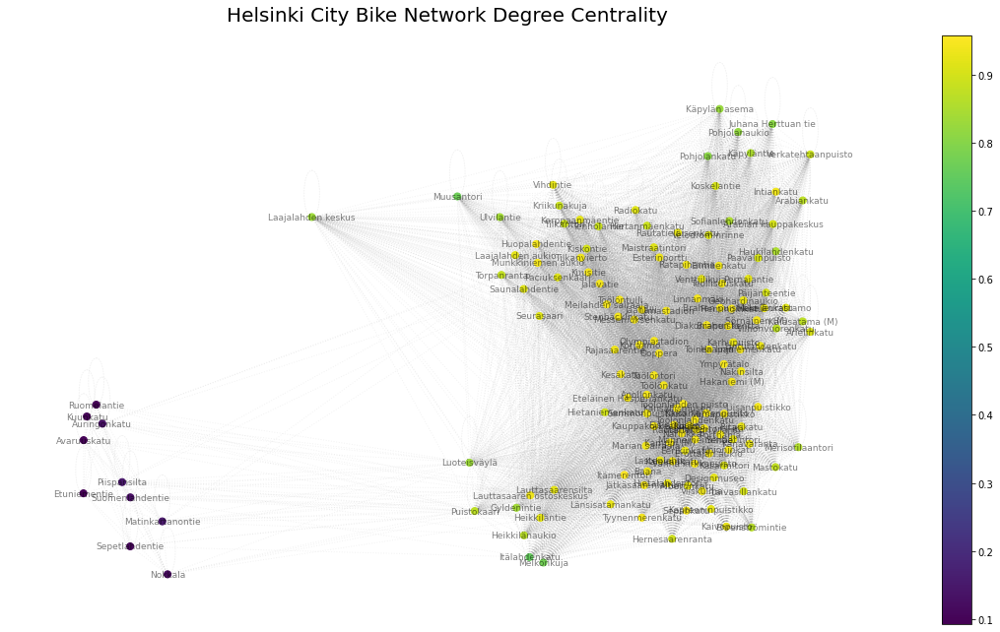

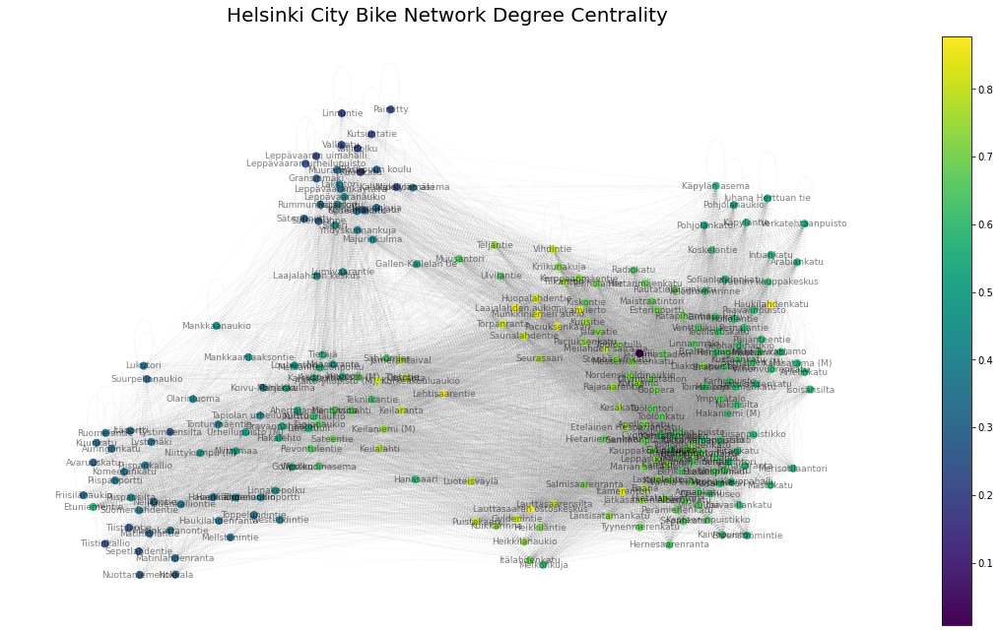

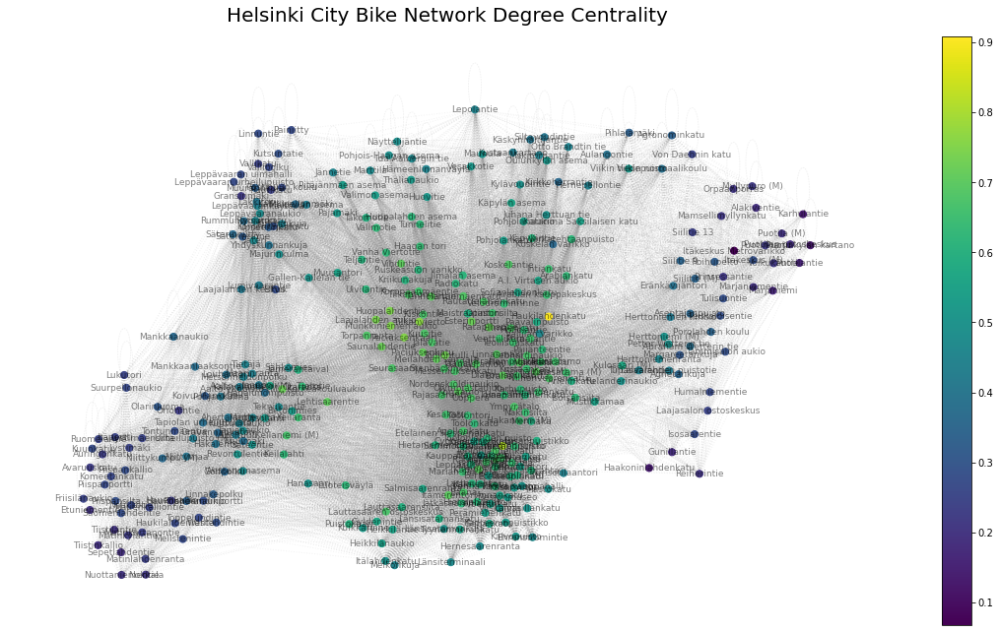

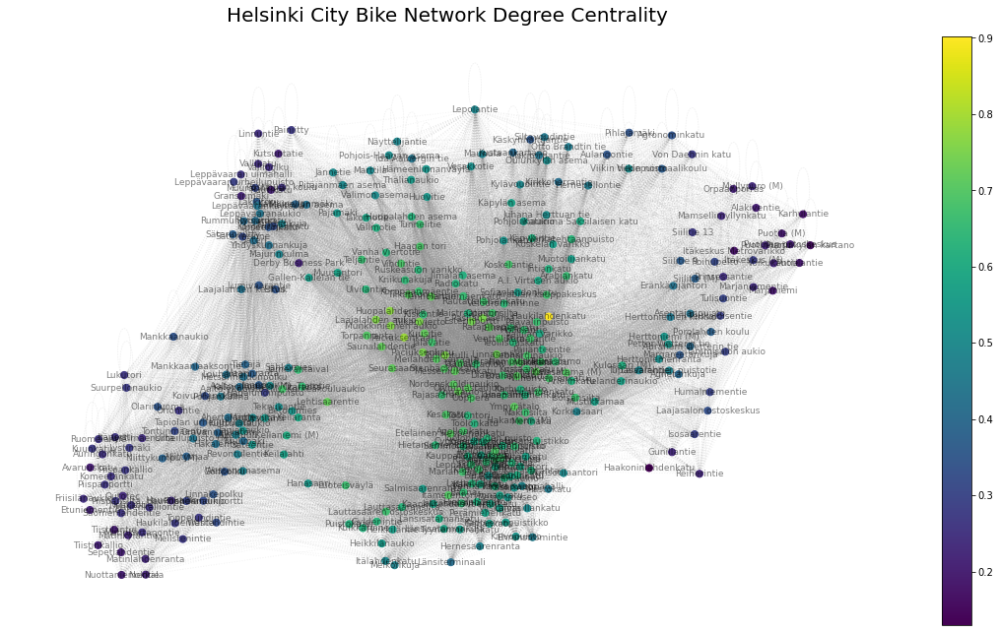

In [126]:
def centralityDegree(G):
    """
    This function plots an interactive City bike network with node degrees
    """
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    degree = nx.degree_centrality(G)
    node_color = [degree[i] for i in degree.keys()]

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos'),node_color=node_color,cmap="viridis", alpha=1, node_size=50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos'),edge_color='grey',style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Degree Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

# function call is commented for performance reasons
for i in network_list[:5]:
    centralityDegree(i)



In [32]:
degree = nx.degree_centrality(y16)
degree.keys()

dict_keys(['Erottajan aukio', 'Hakaniemi (M)', 'Unioninkatu', 'Vanha kirkkopuisto', 'Narinkka', 'Kiasma', 'Ooppera', 'Mannerheimintie', 'Kaivopuisto', 'Senaatintori', 'Ympyrätalo', 'Lastenlehto', 'Rautatientori / länsi', 'Töölönlahdenkatu', 'Kaisaniemenpuisto', 'Ritarikatu', 'Kamppi (M)', 'Sörnäinen (M)', 'Kapteeninpuistikko', 'Designmuseo', 'Töölönkatu', 'Baana', 'Eerikinkatu', 'Rautatientori / itä', 'Merisotilaantori', 'Varsapuistikko', 'Sepänkatu', 'Kauppakorkeakoulu', 'Itämerentori', 'Karhupuisto', 'Kasarmitori', 'Apollonkatu', 'Brahen kenttä', 'Laivasillankatu', 'Töölöntori', 'Eläinmuseo', 'Haapaniemenkatu', 'Kanavaranta', 'Linnanmäki', 'Hietalahdentori', 'Kansallismuseo', 'Liisanpuistikko', 'Mastokatu', 'Viiskulma', 'Porthania', 'Marian sairaala'])

In [67]:
y16.nodes.data('pos')['Erottajan aukio']

(24.9442610720753, 60.166890083486)

In [91]:
degree = nx.degree_centrality(y17)
degree

top_5_nodes = {k: v for k, v in sorted(degree.items(), key=lambda item: item[1],reverse=True)[:5]}
top_5 = list(top_5_nodes.keys())
top_5


# display = y17.nodes.data('pos')[top_5]
    

['Itämerentori',
 'Kesäkatu',
 'Erottajan aukio',
 'Rautatientori / itä',
 'Eläinmuseo']

In [92]:
def centralityDegreeInteractive(G):
    """
    This function plots an interactive network with colorcoded node degrees.
    """
    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = G.nodes[edge[0]]['pos']
        x1, y1 = G.nodes[edge[1]]['pos']
        edge_x.append(x0)
        edge_x.append(x1)
        edge_x.append(None)
        edge_y.append(y0)
        edge_y.append(y1)
        edge_y.append(None)

    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        opacity=0.4,
        line=dict(width=0.5, color='#888', dash='dot'),
        hoverinfo='none',
        mode='lines')

    node_x = []
    node_y = []
    for node in G.nodes():
        x, y = G.nodes[node]['pos']
        node_x.append(x)
        node_y.append(y)

    node_trace = go.Scatter(x=node_x, y=node_y, mode='markers', hoverinfo='text',
        marker=dict(
            showscale=True,
            colorscale='Blues',
            reversescale=True,
            color=[],
            size=10,
            colorbar=dict(thickness=15,title='Node Connections',xanchor='left',titleside='right'),
            line_width=1))

    node_adjacencies = []
    node_text = []
    for node, adjacencies in enumerate(G.adjacency()):
        node_adjacencies.append(len(adjacencies[1]))
        node_text.append('Number of connections: '+str(len(adjacencies[1])))

    node_trace.marker.color = node_adjacencies
    node_trace.text = node_text

    fig = go.Figure(data=[edge_trace, node_trace],
                    layout=go.Layout(
                    width=800,
                    height=500, 
                    title='Helsinki City Bike Network',
                    titlefont_size=16,
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=20,l=5,r=5,t=40),
                    paper_bgcolor='rgba(255,255,255,0)',
                    plot_bgcolor='rgba(255,255,255,1)',
                    annotations=[ dict(
                        text="Helsinki",
                        showarrow=False,
                        xref="paper", yref="paper",
                        x=0.005, y=-0.002 )],
                    xaxis=dict(showgrid=True, zeroline=False, showticklabels=True),
                    yaxis=dict(showgrid=True, zeroline=False, showticklabels=True))
                    )

    fig.show()

# function call is commented for performance reasons

for i in network_list:
    centralityDegreeInteractive(i)

In [4]:
def centralityDegreeDist(G):
    """
    Centrality degree distribution
    """
    # Degree
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())

    # Figure
    fig, ax = plt.subplots(figsize=(20,9))
    plt.plot(deg, cnt, color='mediumturquoise')
    # plt.bar(deg, cnt, width=1, color='mediumturquoise')
    plt.axvline(x = sum(deg)/len(deg), color='r', linestyle='--', linewidth=2) # Degree Mean
    #plt.axvline(x = np.median(deg), color="blue", linestyle='-', linewidth=1) # Degree Median

    # Labeling
    plt.title("Helsinki City Bike Network Degree Distribution")
    plt.ylabel("Count")
    plt.xlabel("Degree")
    plt.text(x= 152,y=6.5, s="Mean", color = 'r', fontsize= 12)
    ax.set_xticks(range(40,340,20))

    plt.show()
    
for i in network_list[1:]:
    centralityDegreeDist(i)

NameError: name 'network_list' is not defined

# Betweenness Centrality

The betweenness centrality captures how much a given node is "in-between" others. This measure calculates the shortest paths between all the nodes of the network and assigns each node a measure based on the number of shortest paths going through the target node. The graph below illustrates the city bike stations by betweenness centrality.

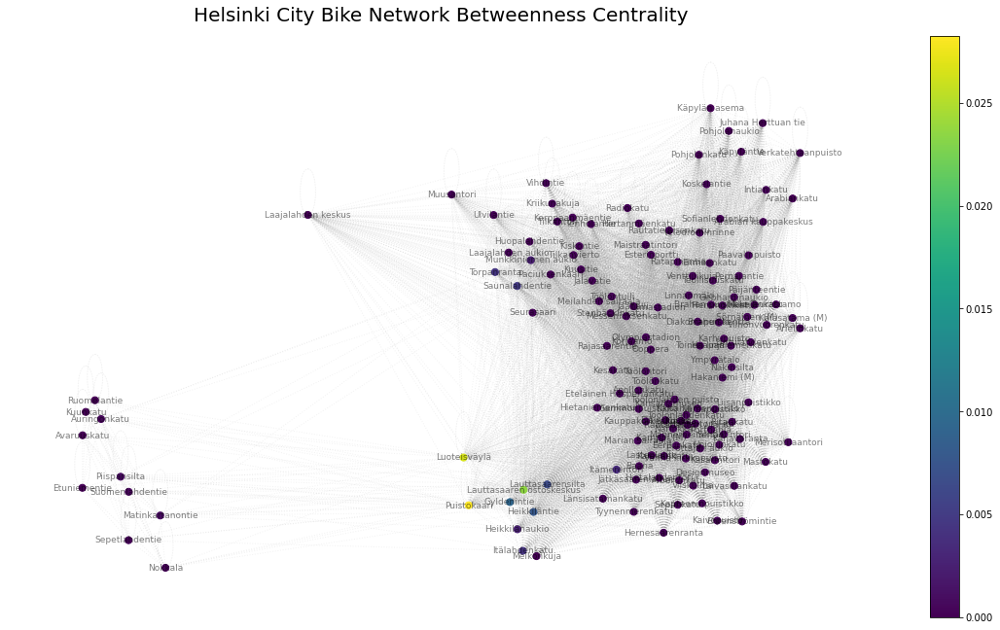

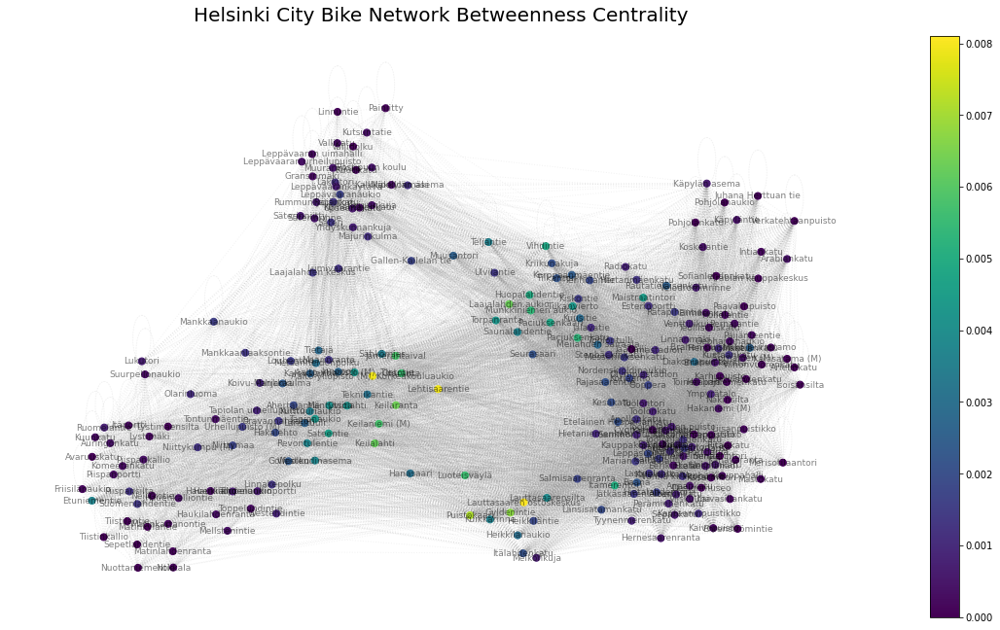

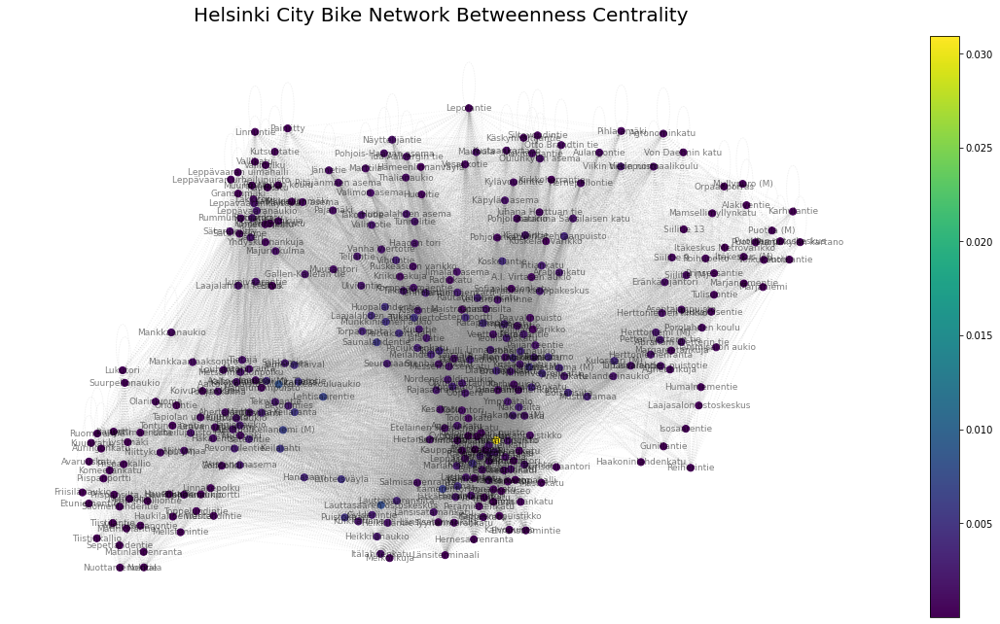

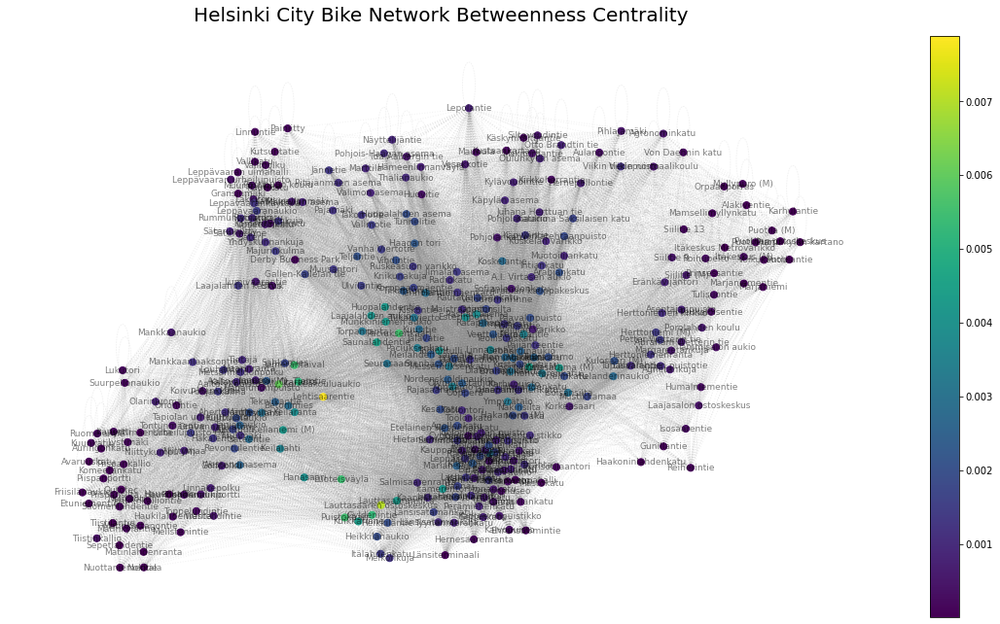

In [119]:
def centralityBetweenness(Graph): 
    """
    This function plots the city bike network betweenes centrality
    """
    
    G = Graph.copy(as_view=False)
    G.remove_node("Haukilahdenkatu")
        
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    betweenness = nx.betweenness_centrality(G)
    node_color = [betweenness[i] for i in betweenness.keys()]

    # Color scale
    colors=range(20,40)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color) - (sum(node_color)/len(node_color))
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Betweenness Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

for i in network_list[1:]:
    centralityBetweenness(i)

In [ ]:
nx.betweenness_centrality()

# Closeness Centrality
Closeness centrality is a way of detecting nodes that are able to distribute flows efficiently through the network. The closeness centrality is calculated as the normalized average of all of its geodesic distances. Within the context of the city bikes, a node with high closeness centrality will indicate stations that can potentially act as versatile intermediary stations within the network.

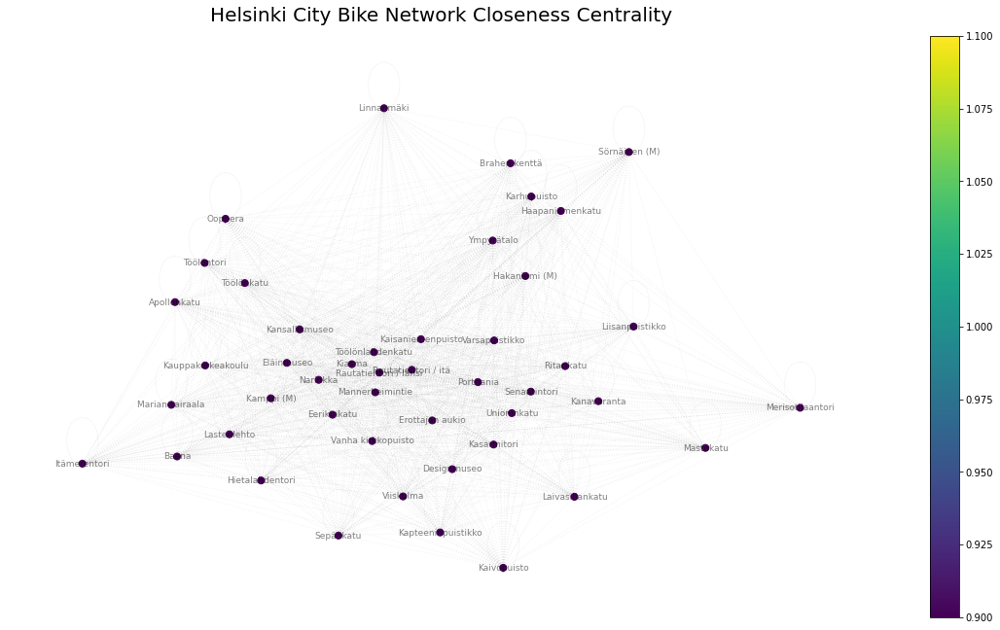

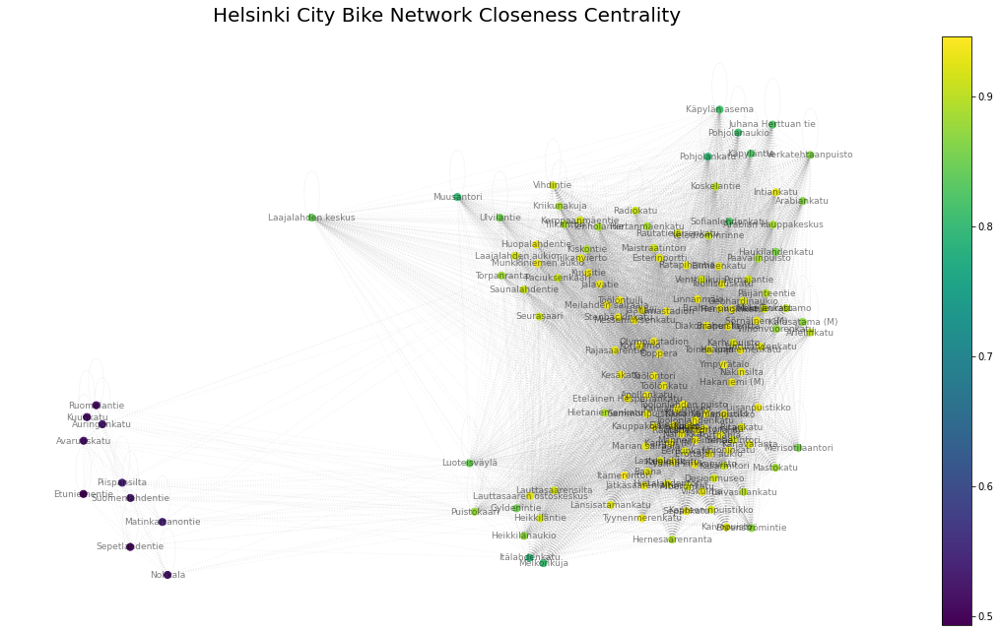

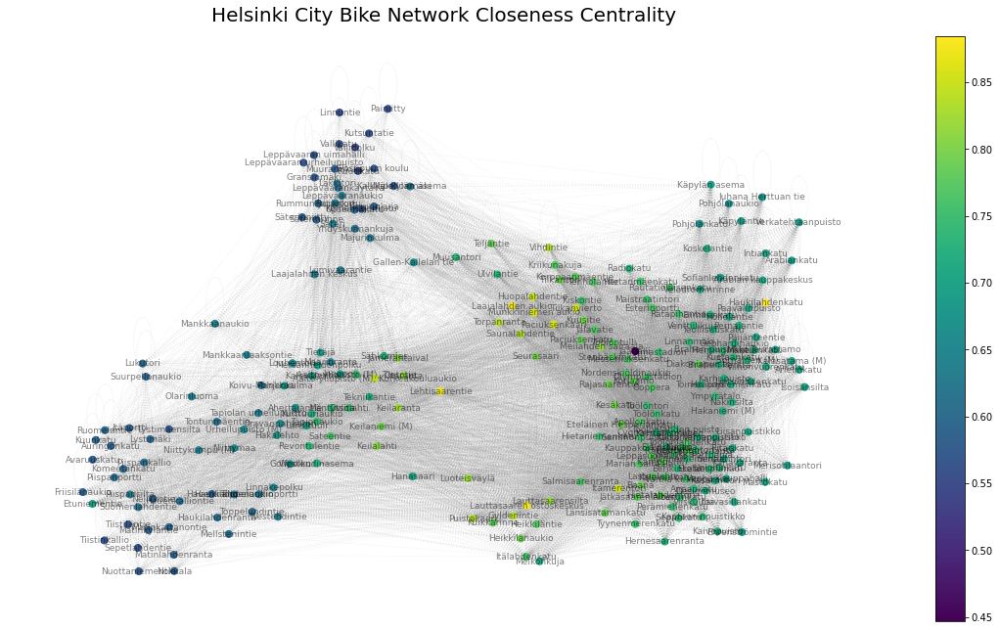

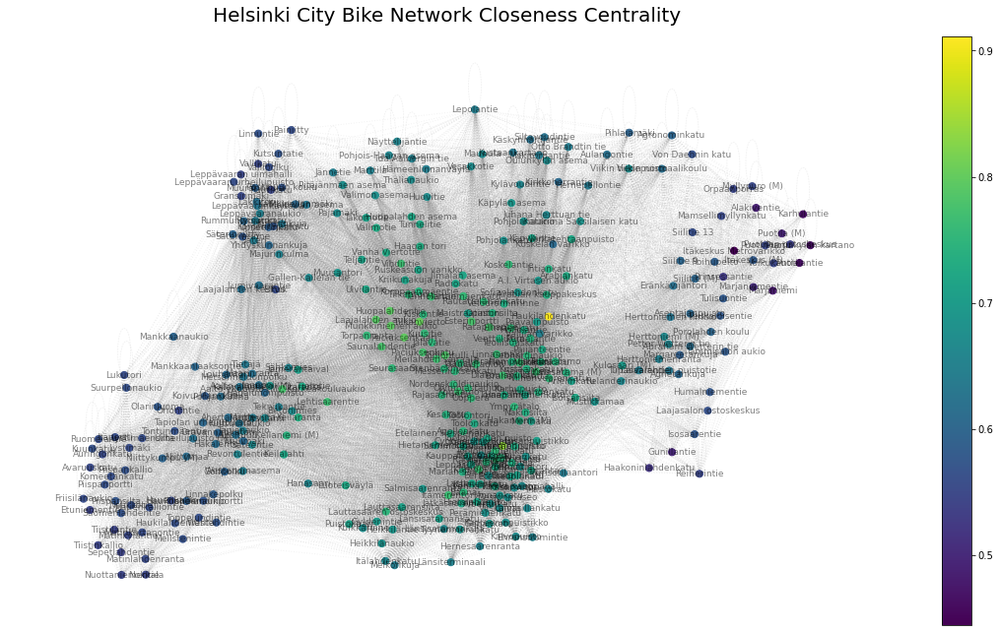

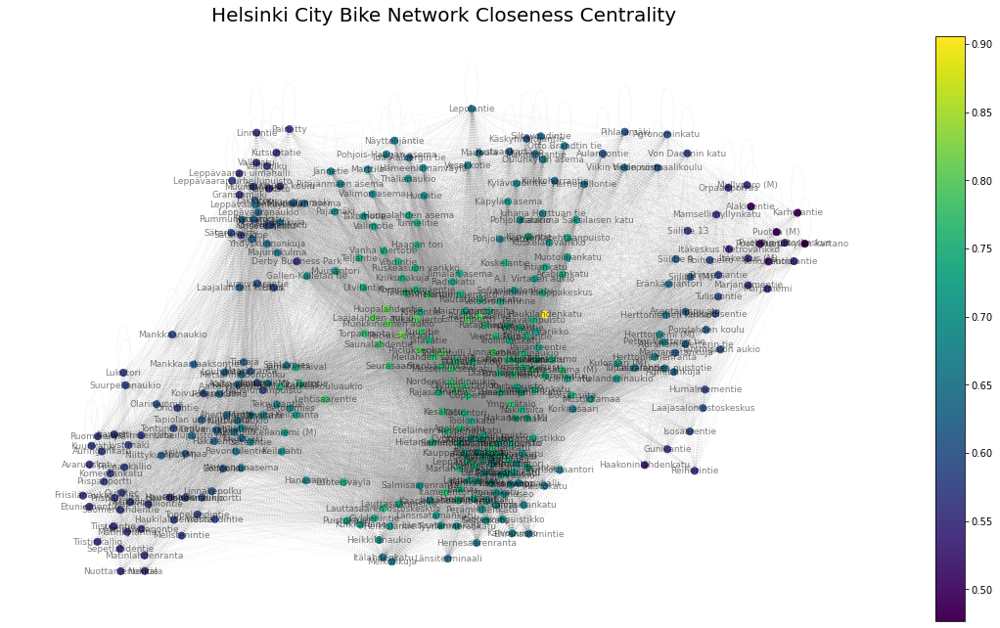

In [129]:
def centralityCloseness(G):
    """
    This function plots an interactive City bike network with node degrees
    """
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    closeness = nx.closeness_centrality(G)
    node_color = [closeness[i] for i in closeness.keys()]

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Closeness Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

for i in network_list:
    centralityCloseness(i)

# Eigenvector centrality & PageRank
Eigenvector centrality measures a node's importance within the network while giving consideration to the importance of its neighbours. Connections to high-scoring eigenvector centrality nodes contribute more to the score than equal connections to low-scoring nodes. In other words, a node with a large number of connections may have a low Eigenvector score if all of its connections are with low-score nodes. A popular variation of eigenvector centrality is Google's PageRank. In essence, PageRank is a variation of normalized eigenvector centrality combined with random jumps. Thus it is not surprising that Pagerank yields result comparable to Eigenvector(graphs below). With this method, stations like the Central Railway Station, Pasila, Lehtisaarentie and Haukilahdenkatu appear as central nodes within the network.

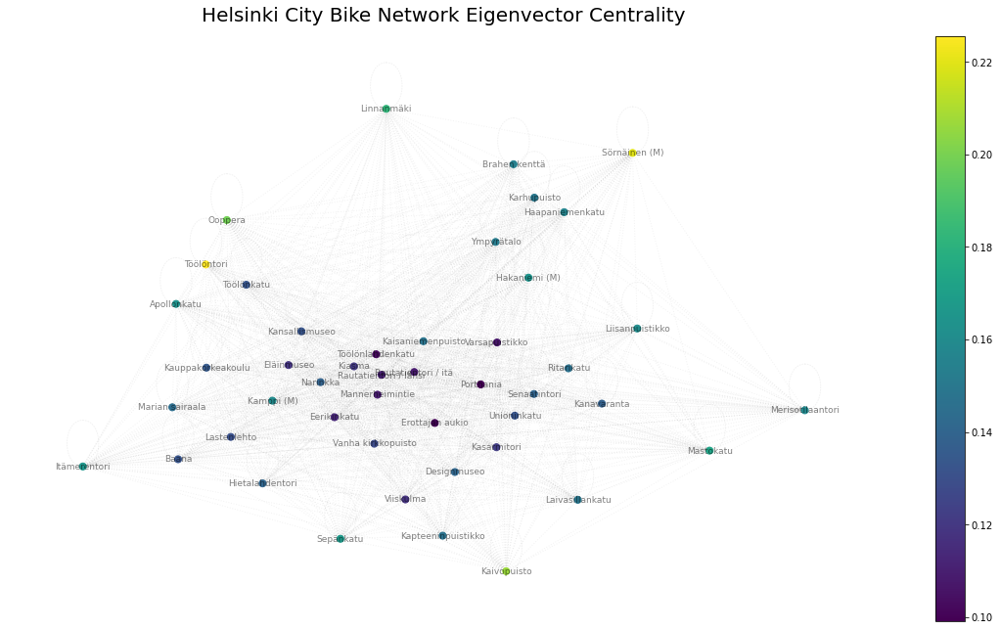

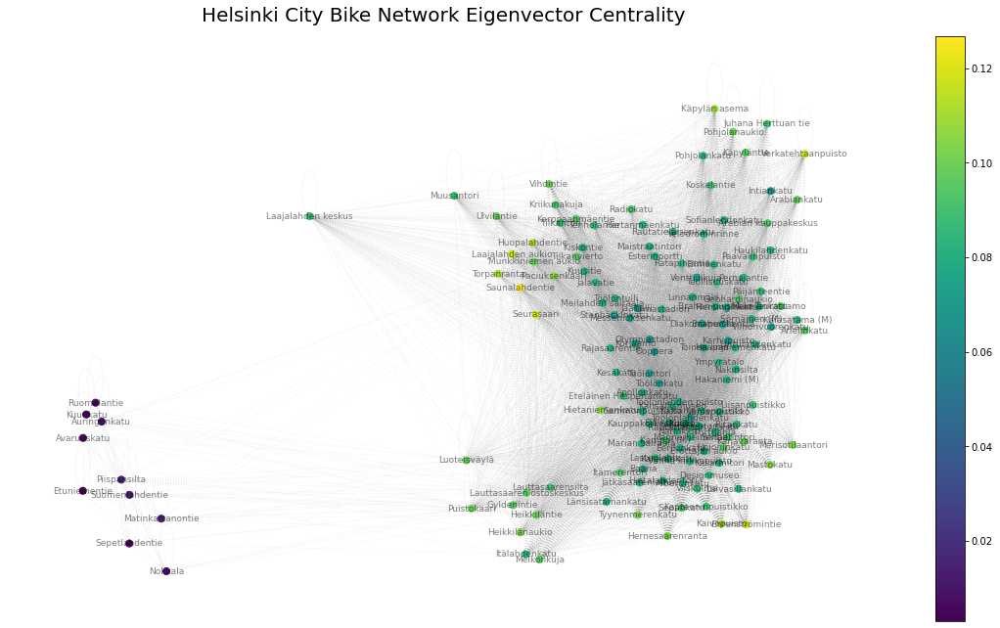

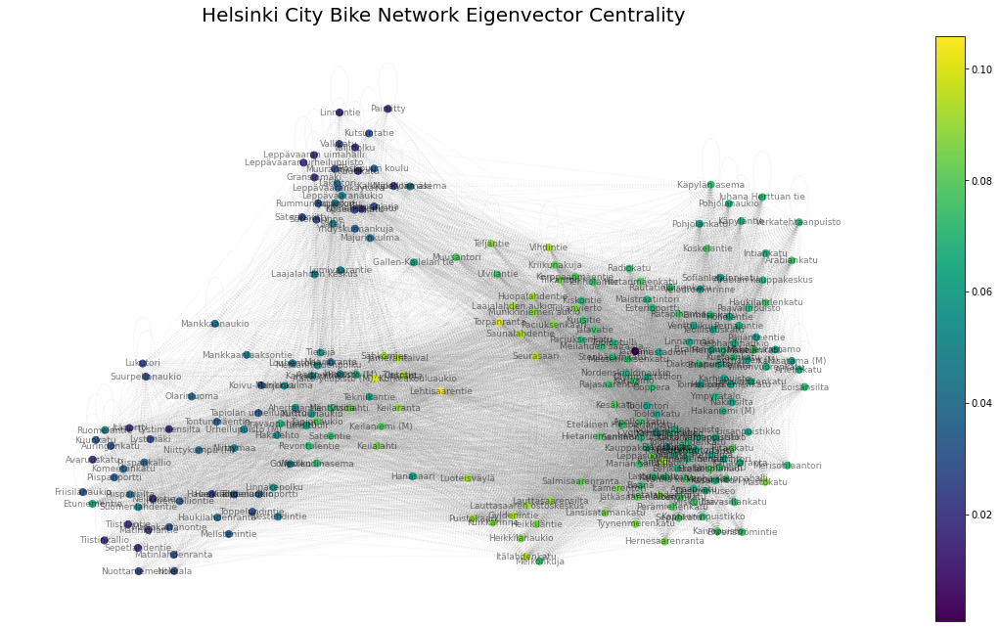

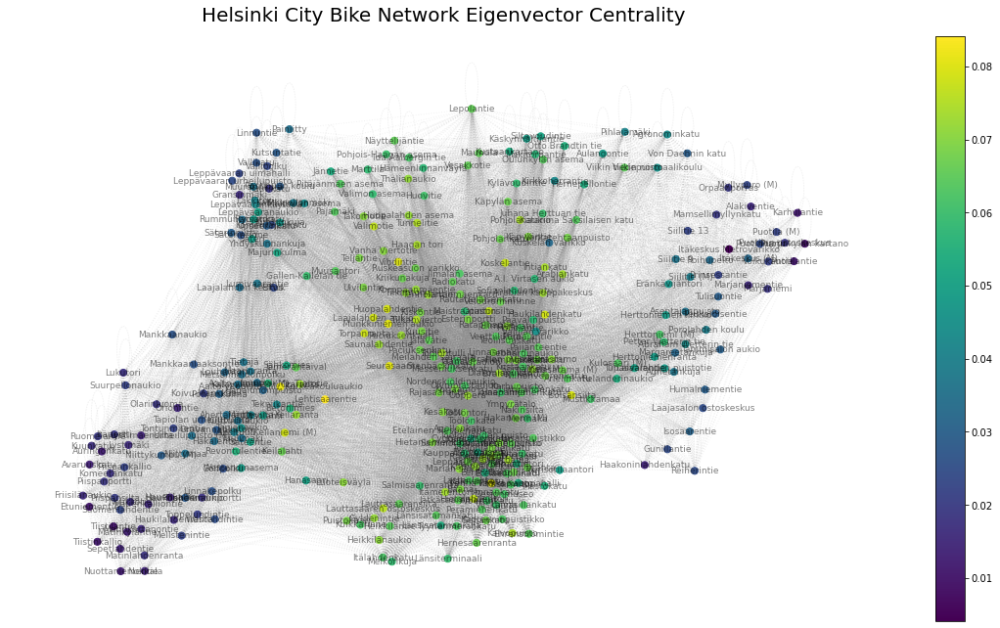

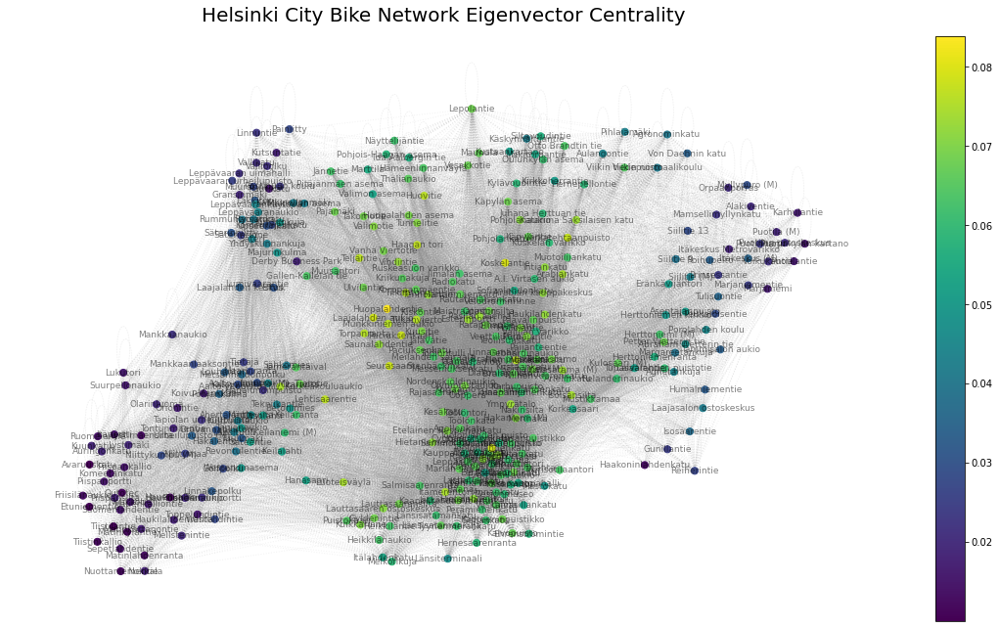

In [131]:
def centralityEigenvector(G):
    """
    This function plots the city bike network Eigenvector centrality
    """
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    eigenvector = nx.eigenvector_centrality(G, max_iter=6000, weight="duration")
    node_color = [eigenvector[i] for i in eigenvector.keys()]

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Eigenvector Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')


# function call is commented for performance reasons
for i in network_list:
    centralityEigenvector(i)

# Combo Method
The majority of exiting community detection strategies iteratively perform one of the following operations: merging two small communities, splitting a large community into two, moving nodes between two distinct communities. The Combo algorithm developed at MIT sensible city lab compounds all three strategies into a sequence. After creating an initial single community, for each source community, the best possible redistribution of all source nodes is calculated then the best grouping is applied. These steps are iteratively repeated until the given fitness criteria are achieved. The graph below illustrates the Combo method applied to the Helsinki city bike network.

In [150]:
def communityCombo(G):
    """
    This function applies the Combo method for community detection on the City bike network.
    """
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    # Partition
    partition, modularity = pycombo.execute(G, return_modularity=True, modularity_resolution= 1,  weight="duration", max_communities=2, random_seed=1)

    # Partition colormap
    cmap = cm.get_cmap('tab20b', max(partition.values()) + 1)

    # Draw Nodes & Edges
    nx.draw_networkx_nodes(G, G.nodes.data('pos'), partition.keys(), node_size=40, cmap=cmap, node_color=list(partition.values()))
    nx.draw_networkx_edges(G, G.nodes.data('pos'), alpha=0.015)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Communities (Combo method)', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

    plt.show()

# communityCombo(y17)

# Louvain Method
Since the previous community detection method did not yield insightful results we can apply a different method that only focuses on the modularity of the network. The Louvain community detection algorithm is chosen due to its beautiful simplicity and the resulting ease of implementation/computation. It allows circumventing the NP-complete problem of maximum cuts in Graphs. Applying the Louvain method to the Helsinki city bike network reveals four distinct communities.

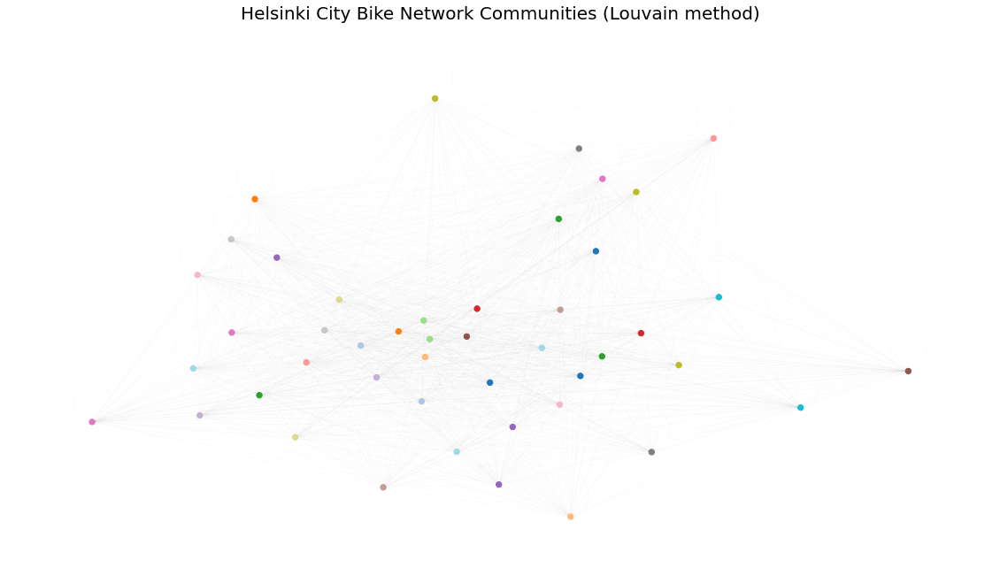

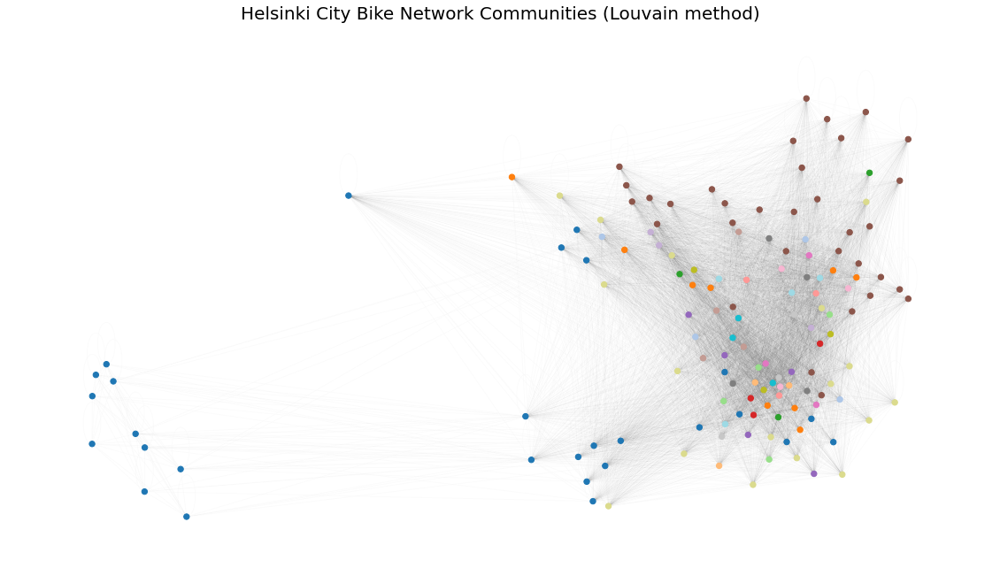

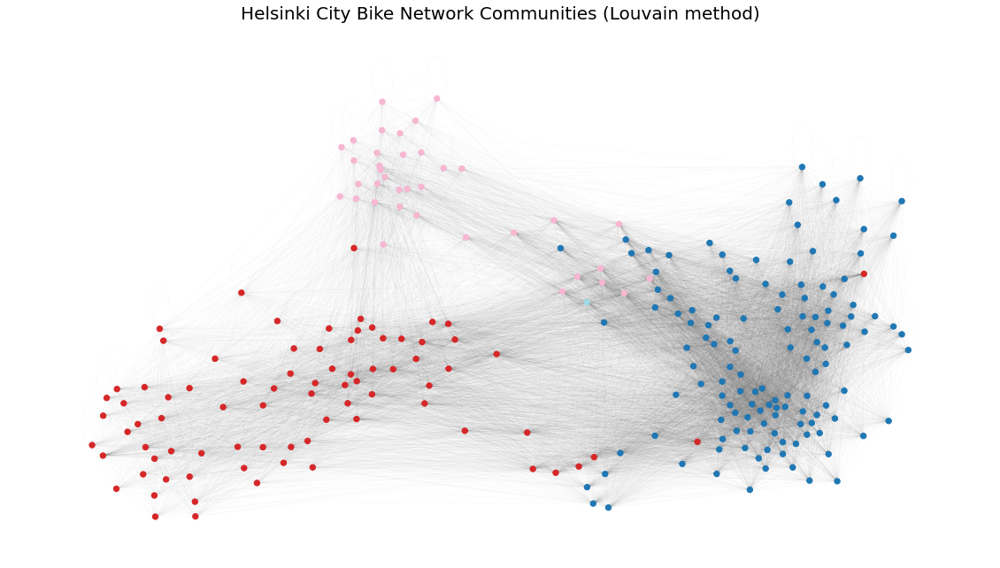

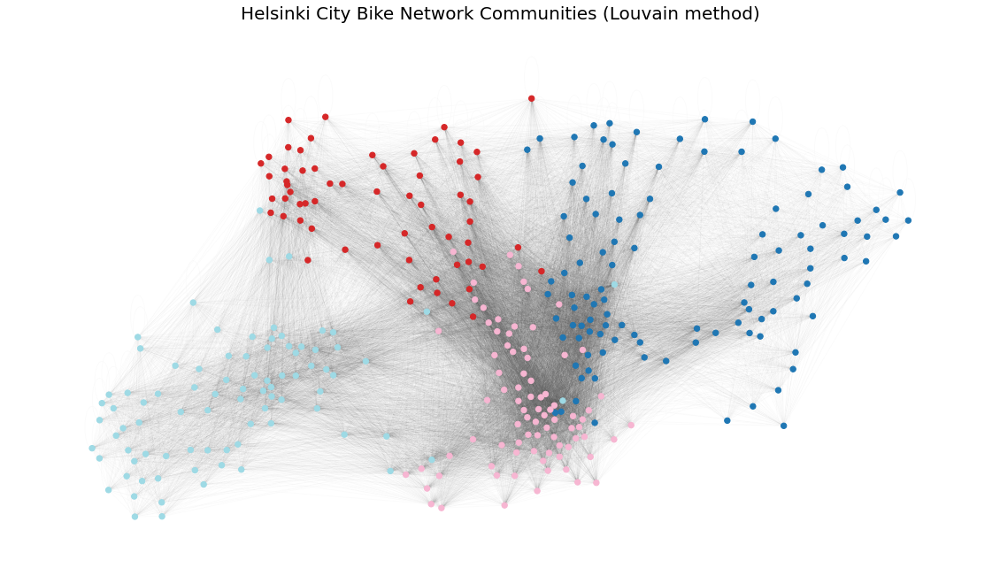

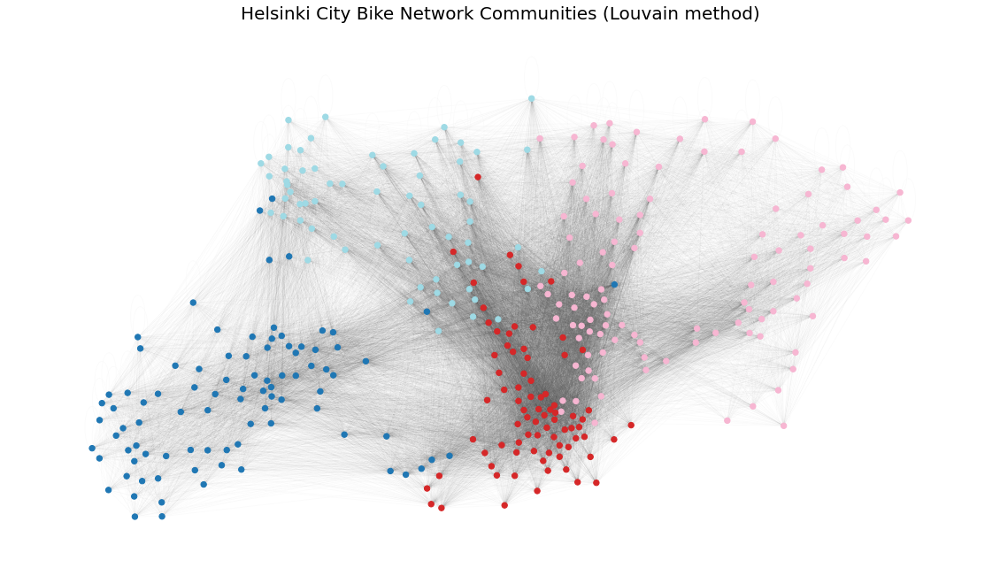

In [156]:
def communityLouvain(G):
    """
    This function applies the Louvain method for community detection on the City bike network.
    """

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    # Compute Louvain method
    partition = community_louvain.best_partition(G, resolution=0.95, random_state=1)

    # Partition colormap
    cmap = cm.get_cmap('tab20', max(partition.values()) + 1)

    # Draw Nodes & Edges
    nx.draw_networkx_nodes(G, G.nodes.data('pos'), partition.keys(), node_size=40, cmap=cmap, node_color=list(partition.values()))
    nx.draw_networkx_edges(G, G.nodes.data('pos'), alpha=0.015)
    # nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),font_size=9,font_color='white',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Communities (Louvain method)', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

    plt.show()
    
for i in network_list:
    communityLouvain(i)

## Fluid Communities Method
The Fluid Communities algorithm is a community detection algorithm based on the idea of introducing a number of fluids within a non-homogeneous environment, where fluids will expand and push each other influenced by the topology of the environment until a stable state is reached. The algorithm does the following. First, it defines each of the starting communities in a random node of the graph. Then the algorithm iterates over all nodes in a random order, updating the community of each node based on its own community and the communities of its neighbours. This process is performed iteratively until convergence.

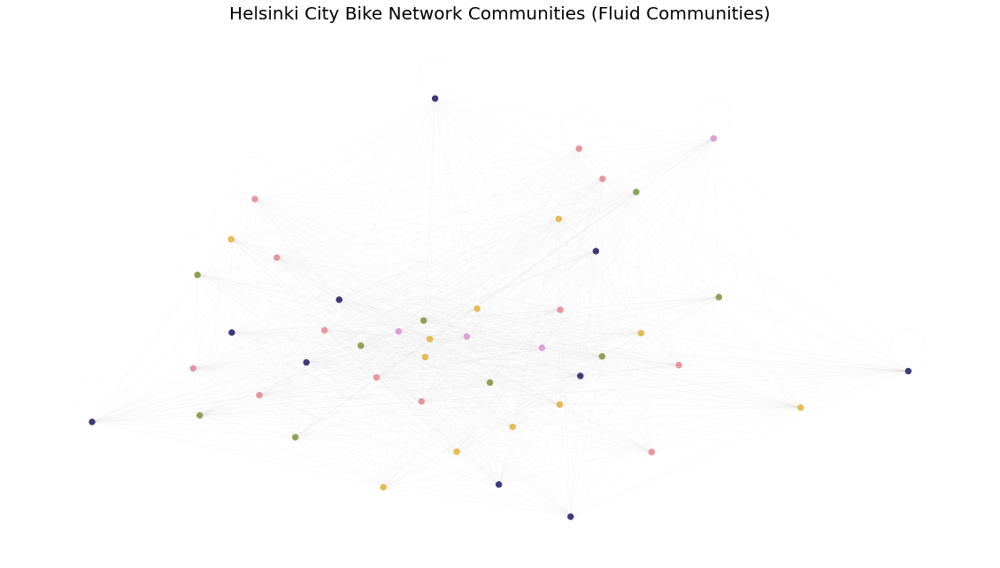

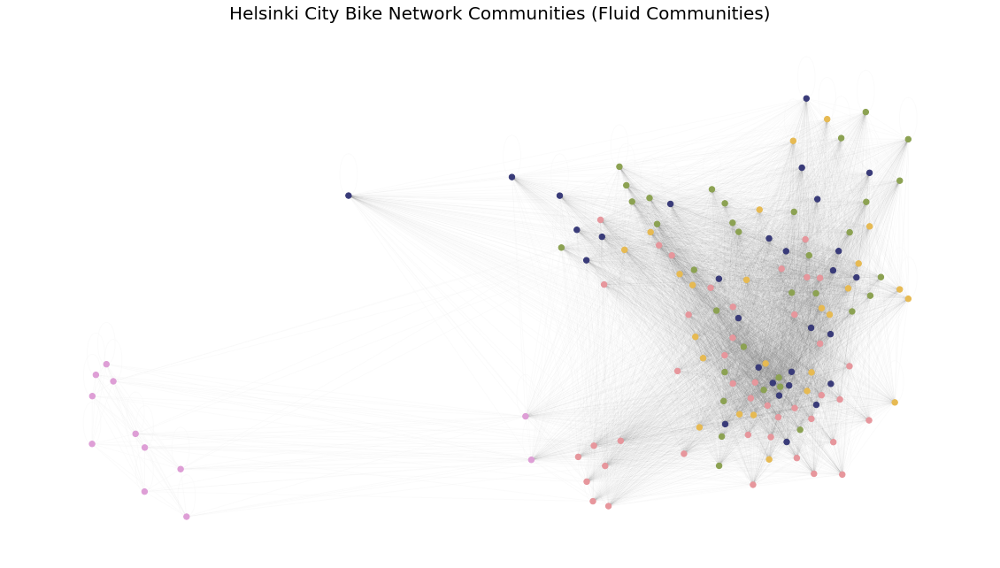

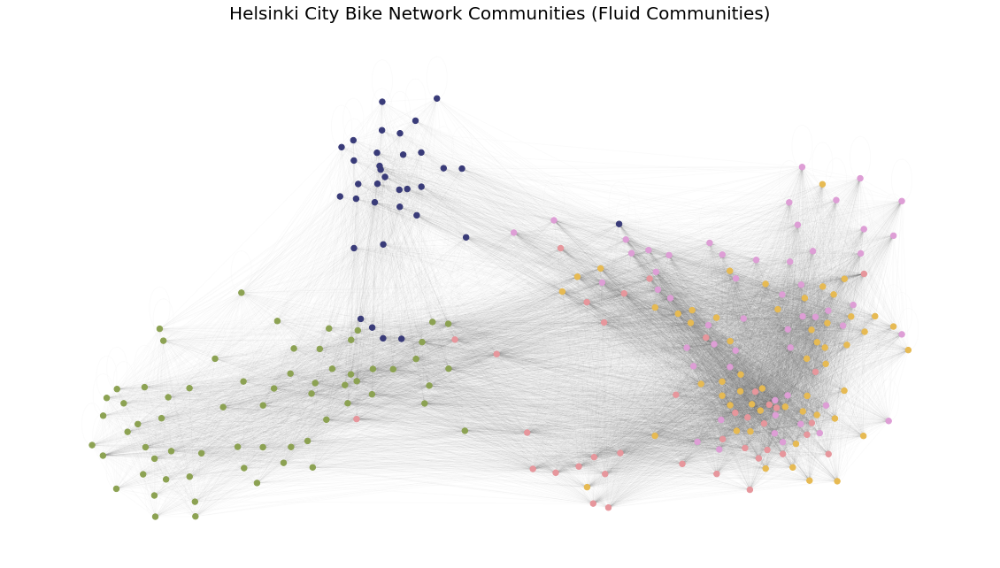

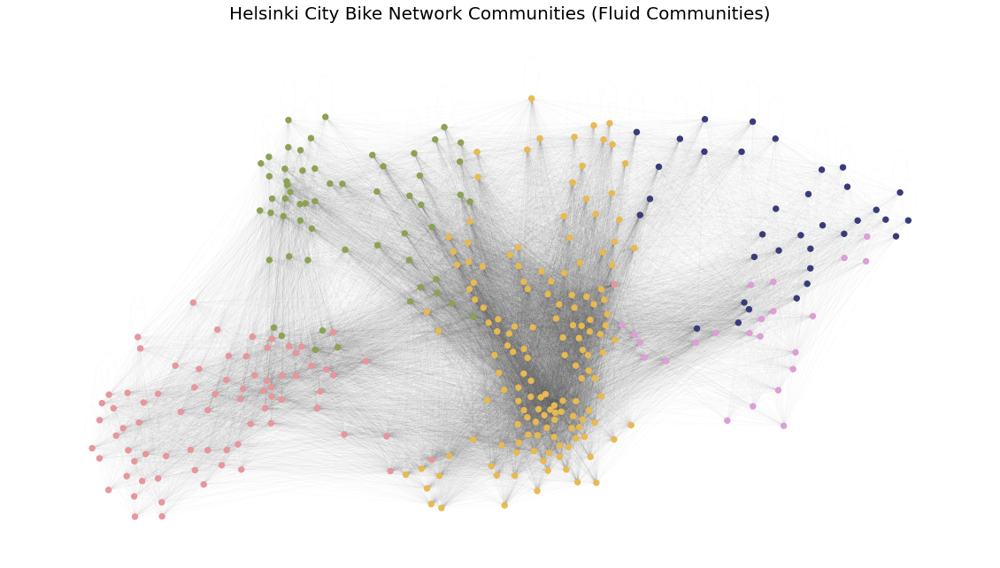

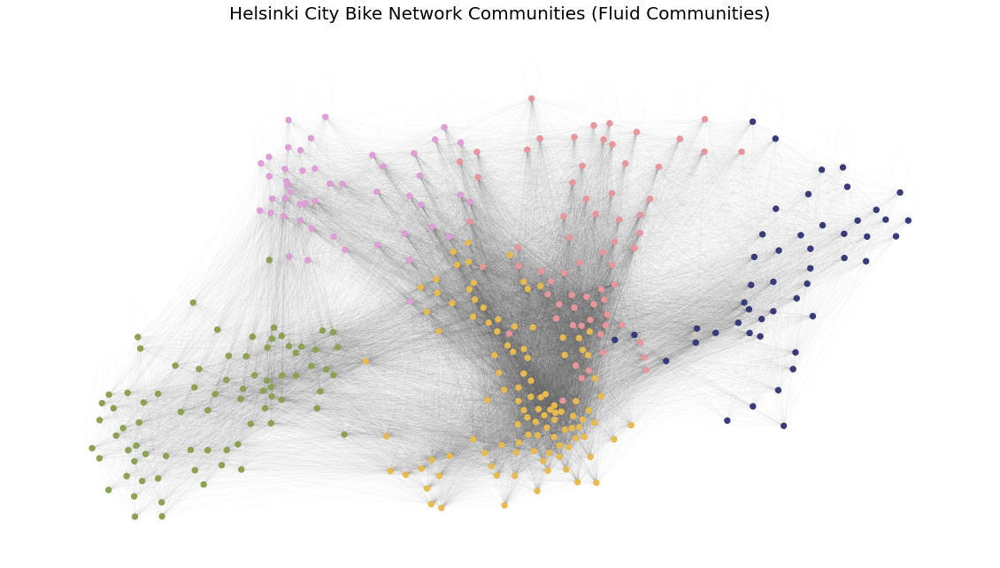

In [159]:
def communityFluid(G):
    """
    This function applies the Fluid Communities method for community detection on the City bike network.
    """

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    # Compute Fluid method
    communities = nx.algorithms.community.asyn_fluid.asyn_fluidc(G, k=5, max_iter=10000, seed=1)
    
    # Assigning each node to its cluster
    partition = {}
    for idx, val in enumerate(communities):
        for k in val:
            partition[k] = idx

    # Partition colormap
    cmap = cm.get_cmap('tab20b', max(partition.values()) + 1)

    # Draw Nodes & Edges
    nx.draw_networkx_nodes(G, G.nodes.data('pos'), partition.keys(), node_size=40, cmap=cmap, node_color=list(partition.values()))
    nx.draw_networkx_edges(G, G.nodes.data('pos'), alpha=0.015)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Communities (Fluid Communities)', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

    plt.show()
    
for i in network_list:
    communityFluid(i)